In [ ]:
# Library
import pandas as pd
import matplotlib.pyplot as plt
import datetime as dt
import numpy as np
import scipy.stats
from sklearn.metrics import root_mean_squared_error
from math import sqrt
import os
from os import listdir
from datetime import datetime
from matplotlib.dates import DateFormatter
import matplotlib.ticker as ticker
import matplotlib.dates as mdates
from sklearn.linear_model import LinearRegression
print("Librerias lista")

In [ ]:

def linear_regression_plot (path, date_format,nrows,ncols, plot, resolucion_espaciotemporal):
    '''
    La función permite graficar la regresión lineal de cada estación AERONET.
    Además, se muestran las estadísticas principales y la ecuación de la regresión lineal.
    Los datos de cada estación de interés se encuentran en una carpeta en formato .csv previamente procesados.
    La función recorre la carpeta y toma cada uno de estos archivos para luego generar el gráfico correspondiente.

    Variables:
    - path: ruta a la carpeta donde se encuentran los archivos en formato .csv
    - date_format: formato de la columna de fecha del archivo de interés.
    Por ejemplo: date_format='%Y-%m-%d %H:%M:%S'
    - nrows: número de filas que tendrá el gráfico
    - ncols: número de columnas que tendrá el gráfico
    - paleta de colores para las estaciones MODIS. Por ejemplo:
    color_modis = ["#74c476","#fed976","#fb6a4a", "#74a9cf","#df65b0","#807dba"]
    color_modis = ["#005a32","#fd8d3c","#99000d","#023858","#ce1256","#3f007d"]
    '''

    i=0 
    j=0 
       

    fig, ax = plt.subplots(ncols=ncols,nrows=nrows,  figsize=(14,6),dpi=500)
    fig.suptitle(resolucion_espaciotemporal, fontsize=16, fontweight='bold')
    #La carpeta contiene todos los archivos a plotear
    for p,files in enumerate(os.listdir(path)):
        print(p)
        N = len(os.listdir(path))
        data = pd.read_csv(os.path.join(path,files))
        station_name = files [2:4]
        date_format='%Y-%m-%d'
        data["Timestamp"] = data["date"].apply(lambda x: datetime.strptime(x,date_format))
        
        #Se convierte en index
        data.set_index('Timestamp', inplace = True)
        data_mean_period_len =len(data.dropna(how='all'))
    
        ########################                VARIABLES                ########################
        #Se toman los datos de cada buffer
        #Buscar forma de no hacerlo tan manual
        df_30 = data[['date', 'AOD_550_modis_mean_30', 'AOD_550_AER_mean_30']]
        y_modis_30= df_30["AOD_550_modis_mean_30"]
        x_aer_30 = df_30['AOD_550_AER_mean_30']
        ##
        df_60 = data[['date', 'AOD_550_modis_mean_60', 'AOD_550_AER_mean_60']]
        y_modis_60= data["AOD_550_modis_mean_60"]
        x_aer_60 = data['AOD_550_AER_mean_60']
        ##
        df_90 = data[['date', 'AOD_550_modis_mean_90', 'AOD_550_AER_mean_90']]
        y_modis_90= data["AOD_550_modis_mean_90"]
        x_aer_90 = data['AOD_550_AER_mean_90']
        ##
        df_120 = data[['date', 'AOD_550_modis_mean_120', 'AOD_550_AER_mean_120']]
        y_modis_120= data["AOD_550_modis_mean_120"]
        x_aer_120 = data['AOD_550_AER_mean_120']

        #Enmascarar los na para cada ventana espacial
        ##30
        mask_30 = ~np.isnan(x_aer_30) & ~np.isnan(y_modis_30)
        x_aer_30 = x_aer_30[mask_30]
        y_modis_30 = y_modis_30[mask_30]

        ##60
        mask_60 = ~np.isnan(x_aer_60) & ~np.isnan(y_modis_60)
        x_aer_60 = x_aer_60[mask_60]
        y_modis_60 = y_modis_60[mask_60]

        ##90
        mask_90 = ~np.isnan(x_aer_90) & ~np.isnan(y_modis_90)
        x_aer_90 = x_aer_90[mask_90]
        y_modis_90 = y_modis_90[mask_90]

        ##120
        mask_120 = ~np.isnan(x_aer_120) & ~np.isnan(y_modis_120)
        x_aer_120 = x_aer_120[mask_120]
        y_modis_120 = y_modis_120[mask_120]

        # #numero de datos sin contar los NaNs
        n_30 = len(x_aer_30)
        n_60 = len(x_aer_60)
        n_90 = len(x_aer_90)
        n_120 = len(x_aer_120)
        # #Calculo la pendiente, la ordenada al origen y el R2
        slope_modis_30 , intercept_modis_30 , r_modis_30 , p_modis_30 , stderr_modis_30  = scipy.stats.linregress(x_aer_30 , y_modis_30)
        slope_modis_60 , intercept_modis_60 , r_modis_60 , p_modis_60 , stderr_modis_60  = scipy.stats.linregress(x_aer_60 , y_modis_60)
        slope_modis_90 , intercept_modis_90 , r_modis_90 , p_modis_90 , stderr_modis_90  = scipy.stats.linregress(x_aer_90 , y_modis_90)
        slope_modis_120 , intercept_modis_120 , r_modis_120 , p_modis_120 , stderr_modis_120  = scipy.stats.linregress(x_aer_120 , y_modis_120)

        # R2
        R2_modis_30 =r_modis_30*r_modis_30
        R2_modis_60 =r_modis_60*r_modis_60
        R2_modis_90 =r_modis_90*r_modis_90
        R2_modis_120 =r_modis_120*r_modis_120

        #Calculo RMSE
        RMSE_modis_30 = root_mean_squared_error(y_modis_30, x_aer_30, squared = False)
        RMSE_modis_60 = root_mean_squared_error(y_modis_60, x_aer_60, squared = False)
        RMSE_modis_90 = root_mean_squared_error(y_modis_90, x_aer_90, squared = False)
        RMSE_modis_120 = root_mean_squared_error(y_modis_120, x_aer_120, squared = False)
        #Bias
        bias_modis_30 = round(( sum(y_modis_30 - x_aer_30)/n_30),3)
        bias_modis_60 = round(( sum(y_modis_60 - x_aer_60)/n_60),3)
        bias_modis_90 = round(( sum(y_modis_90 - x_aer_90)/n_90),3)
        bias_modis_120 = round(( sum(y_modis_120 - x_aer_120)/n_120),3)
        
        RMSE_modis_normalize_30 = round(RMSE_modis_30/(x_aer_30.mean()),3)
        RMSE_modis_normalize_60 = round(RMSE_modis_60/(x_aer_60.mean()),3)
        RMSE_modis_normalize_90 = round(RMSE_modis_90/(x_aer_90.mean()),3)
        RMSE_modis_normalize_120 = round(RMSE_modis_120/(x_aer_120.mean()),3)

        ########################                PREDICT                ########################

       # Calculos varios para cada buffer
        y_modis_p_30 = y_modis_30.values.reshape(-1,1)
        x_p_30 = x_aer_30.values.reshape(-1,1)
        ##
        y_modis_p_60 = y_modis_60.values.reshape(-1,1)
        x_p_60 = x_aer_60.values.reshape(-1,1)
        ##
        y_modis_p_90 = y_modis_90.values.reshape(-1,1)
        x_p_90 = x_aer_90.values.reshape(-1,1)
        ##
        y_modis_p_120 = y_modis_120.values.reshape(-1,1)
        x_p_120 = x_aer_120.values.reshape(-1,1)

        ######
        linear_regresion_modis_30 = LinearRegression()
        linear_regresion_modis_30.fit(x_p_30,y_modis_p_30)
        li_predict_modis_30= linear_regresion_modis_30.predict(x_p_30)
        ##
        linear_regresion_modis_60 = LinearRegression()
        linear_regresion_modis_60.fit(x_p_60,y_modis_p_60)
        li_predict_modis_60 = linear_regresion_modis_60.predict(x_p_60)
        ##
        linear_regresion_modis_90 = LinearRegression()
        linear_regresion_modis_90.fit(x_p_90,y_modis_p_90)
        li_predict_modis_90 = linear_regresion_modis_90.predict(x_p_90)

        ##
        linear_regresion_modis_120 = LinearRegression()
        linear_regresion_modis_120.fit(x_p_120,y_modis_p_120)
        li_predict_modis_120 = linear_regresion_modis_120.predict(x_p_120)
        
        # Hacemos calculos promedios
        R2_modis_promedio = round(((R2_modis_30+R2_modis_60+R2_modis_90+R2_modis_120)/4),3)
        RMSE_modis_promedio = round(((RMSE_modis_30+RMSE_modis_60+RMSE_modis_90+RMSE_modis_120)/4),3)
        NRMSE_modis_promedio = round(((RMSE_modis_normalize_30+RMSE_modis_normalize_60+RMSE_modis_normalize_90+RMSE_modis_normalize_120)/4),3)
        bias_modis_promedio = round(((bias_modis_30+bias_modis_60+bias_modis_90+bias_modis_120)/4),3)
        
        R2_modis_min = round(min(R2_modis_30,R2_modis_60,R2_modis_90,R2_modis_120),3)
        RMSE_modis_min = round(min(RMSE_modis_30,RMSE_modis_60,RMSE_modis_90,RMSE_modis_120),3)
        NRMSE_modis_min = round(min(RMSE_modis_normalize_30,RMSE_modis_normalize_60,RMSE_modis_normalize_90,RMSE_modis_normalize_120),3)
        bias_modis_min = round(min(bias_modis_30,bias_modis_60,bias_modis_90,bias_modis_120),3)
        
        R2_modis_max = round(max(R2_modis_30,R2_modis_60,R2_modis_90,R2_modis_120),3)
        RMSE_modis_max = round(max(RMSE_modis_30,RMSE_modis_60,RMSE_modis_90,RMSE_modis_120),3)
        NRMSE_modis_max = round(max(RMSE_modis_normalize_30,RMSE_modis_normalize_60,RMSE_modis_normalize_90,RMSE_modis_normalize_120),3)
        bias_modis_max = round(max(bias_modis_30,bias_modis_60,bias_modis_90,bias_modis_120),3)

    #### 
        #fig.suptitle(resolucion_espaciotemporal, fontsize=16, fontweight='bold')
         ########################                PLOT                ########################
                # Figure
           # Se silencian los plots para ver los valore nomas pero se deberia poner el plot
#         ax[i][j].plot(x_p_30,li_predict_modis_30,c="#3182bd",linestyle="-",linewidth=2.5)#azul
#         ax[i][j].plot(x_p_60,li_predict_modis_60,c="#2ca25f",linestyle="-",linewidth=2.5)#verde
#         ax[i][j].plot(x_p_90,li_predict_modis_90,c="#de2d26",linestyle="-",linewidth=2.5)#Rojo
#         ax[i][j].plot(x_p_120,li_predict_modis_120,c="#756bb1",linestyle="-",linewidth=2.5)#Violeta
        ax[i][j].set_xlim(0, 1.6)
        ax[i][j].set_ylim(0, 1.6)
        ax[i][j].yaxis.set_ticks(np.arange(0, 1.62, 0.2))
        ax[i][j].xaxis.set_ticks(np.arange(0, 1.62, 0.2))
        ## Linear regression equation
        ax[i][j].text(0.05, 1.4, "modis 30 =", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.43, 1.4, (str(round (intercept_modis_30,2)) + " + "+ str(round (slope_modis_30,2))+ " AOD") , fontsize=8, ha="left", va="bottom")#, bbox=dict(boxstyle="round", fc=(1.0, 0.99, 0.99)))
        ax[i][j].text(0.05, 1.3, "modis 60 =", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.43, 1.3, (str(round (intercept_modis_60,2)) + " + "+ str(round (slope_modis_60,2))+ " AOD") , fontsize=8, ha="left", va="bottom")#, bbox=dict(boxstyle="round", fc=(1.0, 0.99, 0.99)))
        ax[i][j].text(0.05, 1.2, "modis 90 =", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.43, 1.2, (str(round (intercept_modis_90,2)) + " + "+ str(round (slope_modis_90,2))+ " AOD") , fontsize=8, ha="left", va="bottom")#, bbox=dict(boxstyle="round", fc=(1.0, 0.99, 0.99)))
        ax[i][j].text(0.05, 1.1, "modis 120 =", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.45, 1.1, (str(round (intercept_modis_120,2)) + " + "+ str(round (slope_modis_120,2))+ " AOD") , fontsize=8, ha="left", va="bottom")#, bbox=dict(boxstyle="round", fc=(1.0, 0.99, 0.99)))
        
        ax[i][j].text(0.05, 1.0, "R2 Prom =", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.4, 1.0, (str(R2_modis_promedio)), fontsize=8, ha="left", va="bottom")
        ax[i][j].text(0.6, 1.0, "Min = ", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.85, 1.0, (str(R2_modis_min)), fontsize=8, ha="left", va="bottom")
        ax[i][j].text(1.05, 1.0, "Max = ", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(1.25, 1.0, (str(R2_modis_max)), fontsize=8, ha="left", va="bottom")
       
        ax[i][j].text(0.05, 0.9, "RMSE Prom = ", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.5,  0.9, (str(RMSE_modis_promedio)), fontsize=8, ha="left", va="bottom")
        ax[i][j].text(0.7,  0.9, "Min = ", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.9,  0.9, (str(RMSE_modis_min)), fontsize=8, ha="left", va="bottom")
        ax[i][j].text(1.1,  0.9, "Max = ", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(1.35,  0.9, (str(RMSE_modis_max)), fontsize=8, ha="left", va="bottom")
 
        
        ax[i][j].text(0.05, 0.8, "NRMSE Prom = ", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.55,  0.8, (str(NRMSE_modis_promedio)), fontsize=8, ha="left", va="bottom")
        ax[i][j].text(0.72,  0.8, "Min = ", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.9,  0.8, (str(NRMSE_modis_min)), fontsize=8, ha="left", va="bottom")
        ax[i][j].text(1.1,  0.8, "Max = ", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(1.35,  0.8, (str(NRMSE_modis_max)), fontsize=8, ha="left", va="bottom")
       
        
        ax[i][j].text(0.05, 0.7, "Bias Prom = ", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.45,  0.7, (str(bias_modis_promedio)), fontsize=8, ha="left", va="bottom")
        ax[i][j].text(0.68,  0.7, "Min = ", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.9,  0.7, (str(bias_modis_min)), fontsize=8, ha="left", va="bottom")
        ax[i][j].text(1.1,  0.7, "Max = ", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(1.35,  0.7, (str(bias_modis_max)), fontsize=8, ha="left", va="bottom")
     
    # Statistics by station
        ax[i][j].text(0.6, 0.5, r'$R^{2}$ ', fontsize=8, ha="left", va="center")
        ax[i][j].text(0.6, 0.4, r'$RMSE$ ',fontsize=8,ha="left", va="center")
        ax[i][j].text(0.55, 0.3, r'$NRMSE$ ',fontsize=8,ha="left", va="center")
        ax[i][j].text(0.6, 0.2, r'$Bias$', fontsize=8,ha="left", va="center")
        ax[i][j].text(0.6, 0.1, r'$n$    ', fontsize=8,ha="left", va="center")

        # Statistics by station for  modis
        ax[i][j].text(0.86, 0.6, "30" , fontsize=8, ha="center", va="bottom",fontweight = "bold")
        ax[i][j].text(0.8, 0.5,(round(R2_modis_30,3)) , fontsize=8, ha="left", va="center")
        ax[i][j].text(0.8, 0.4,   (round(RMSE_modis_30,3)) , fontsize=8,ha="left", va="center")
        ax[i][j].text(0.8, 0.3,   (round(RMSE_modis_normalize_30,3)) , fontsize=8,ha="left", va="center")
        ax[i][j].text(0.8, 0.2,  bias_modis_30, fontsize=8,ha="left", va="center")#,
        ax[i][j].text(0.84, 0.1,  n_30 , fontsize=8,ha="left", va="center")

        # Statistics by station for  modis
        ax[i][j].text(1.06, 0.6, "60" , fontsize=8, ha="center", va="bottom",fontweight = "bold")
        ax[i][j].text(1, 0.5,(round(R2_modis_60,3)) , fontsize=8, ha="left", va="center")
        ax[i][j].text(1, 0.4,   (round(RMSE_modis_60,3)) , fontsize=8,ha="left", va="center")
        ax[i][j].text(1, 0.3,   (round(RMSE_modis_normalize_60,3)) , fontsize=8,ha="left", va="center")
        ax[i][j].text(1, 0.2,  bias_modis_60, fontsize=8,ha="left", va="center")#,
        ax[i][j].text(1.04, 0.1,  n_60 , fontsize=8,ha="left", va="center")

        # Statistics by station for  modis
        ax[i][j].text(1.26, 0.6, "90" , fontsize=8, ha="center", va="bottom",fontweight = "bold")
        ax[i][j].text(1.2, 0.5,(round(R2_modis_90,3)) , fontsize=8, ha="left", va="center")
        ax[i][j].text(1.2, 0.4,   (round(RMSE_modis_90,3)) , fontsize=8,ha="left", va="center")
        ax[i][j].text(1.2, 0.3,   (round(RMSE_modis_normalize_90,3)) , fontsize=8,ha="left", va="center")
        ax[i][j].text(1.2, 0.2,  bias_modis_90, fontsize=8,ha="left", va="center")#,
        ax[i][j].text(1.24, 0.1,  n_90 , fontsize=8,ha="left", va="center")

#         # Statistics by station for  modis
        ax[i][j].text(1.46, 0.6, "120" , fontsize=8, ha="center", va="bottom",fontweight = "bold")
        ax[i][j].text(1.4, 0.5,(round(R2_modis_120,3)) , fontsize=8, ha="left", va="center")
        ax[i][j].text(1.4, 0.4,   (round(RMSE_modis_120,3)) , fontsize=8,ha="left", va="center")
        ax[i][j].text(1.4, 0.3,   (round(RMSE_modis_normalize_120,3)) , fontsize=8,ha="left", va="center")
        ax[i][j].text(1.4, 0.2,  bias_modis_120, fontsize=8,ha="left", va="center")#,
        ax[i][j].text(1.44, 0.1,  n_120 , fontsize=8,ha="left", va="center")
        #Titulo de cada subplots 
        ax[i][j].set_title(station_name,fontsize=13,fontdict={'family': 'serif', 
            'color' : 'Black',
            'weight': 'bold',
            'size': 16})

        # Axes names
        ax[i][j].set_xlabel(r'$AOD_{AERONET}$',size=10)
        ax[i][j].set_ylabel(r'$AOD_{SATELLITE}$',size=10)
        plt.subplots_adjust(left=0.125,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.2, 
                    hspace=0.4)
       
        
         
        # Location of data in each subplot
        if j == ncols-1:
            i = i+1
            j = 0
        else:
            j = j+1
   # Save the plot to the current path
    if plot == 'save':
        return(plt.savefig("linear_regression_plot.jpg", dpi=500))
    else:
        return(plt.show())


0
1
2
3
4
5


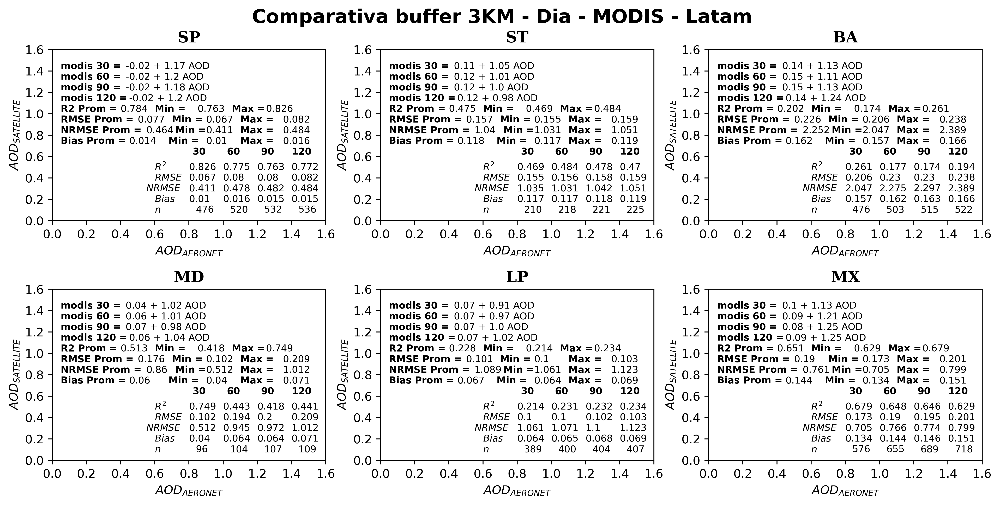

In [72]:
### "Comparativa buffer 3KM -"
resolucion_espaciotemporal_3KM = "Comparativa buffer 3KM - Dia - MODIS - Latam"
# date_format= '%Y-%m-%d %H:%M:%S'
date_format = '%d/%m/%Y'
ncols = 3
nrows = 2
plot = "no"
dir_path_latam_3KM="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/Latam/horario/3km"
regresion_3km = linear_regression_plot (resolucion_espaciotemporal = resolucion_espaciotemporal_3KM, path=dir_path_latam_3KM,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)

0
1
2
3
4
5


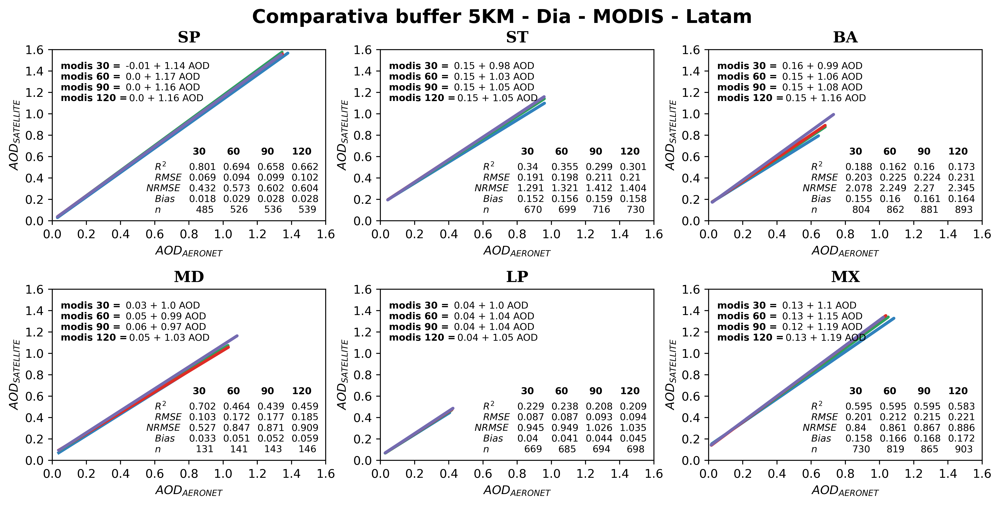

In [ ]:
### "Comparativa buffer 5KM - Dia para los distintos horarios
resolucion_espaciotemporal_3KM = "Comparativa buffer 5KM - Dia - MODIS - Latam"
date_format = '%d/%m/%Y'
ncols = 3
nrows = 2
plot = "no"
dir_path_latam_3KM="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/Latam/horario/5km"
regresion_3km = linear_regression_plot (resolucion_espaciotemporal = resolucion_espaciotemporal_3KM, path=dir_path_latam_3KM,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)

0
1
2
3
4
5


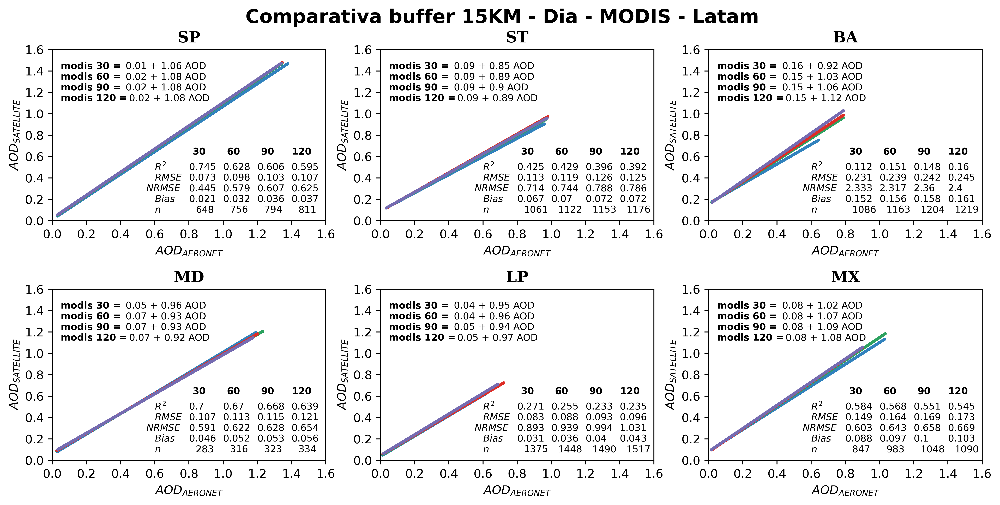

In [ ]:
### "Comparativa buffer 15KM - Dia para los distintos horarios
resolucion_espaciotemporal_3KM = "Comparativa buffer 15KM - Dia - MODIS - Latam"
# date_format= '%Y-%m-%d %H:%M:%S'
date_format = '%d/%m/%Y'
ncols = 3
nrows = 2
plot = "no"
dir_path_latam_3KM="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/Latam/horario/15km"
regresion_3km = linear_regression_plot (resolucion_espaciotemporal = resolucion_espaciotemporal_3KM, path=dir_path_latam_3KM,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)

0
1
2
3
4
5


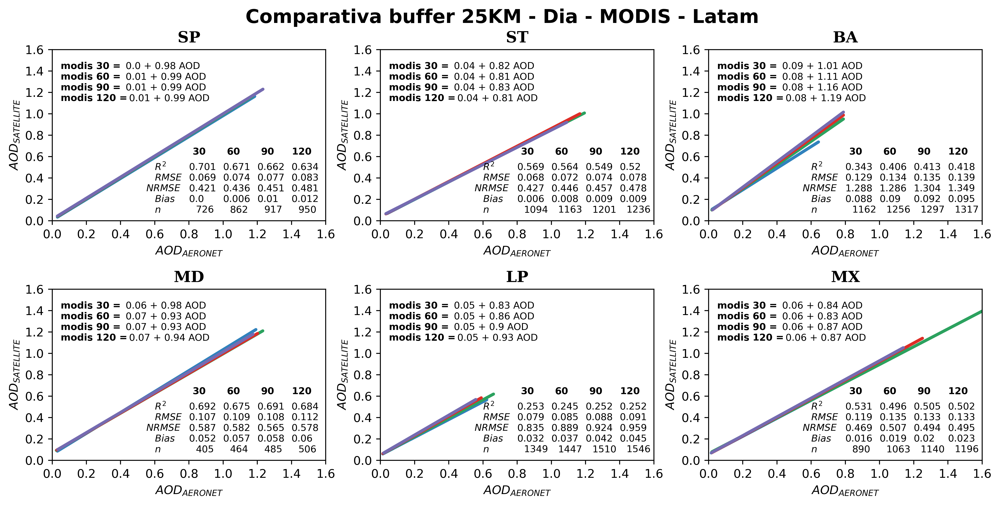

In [ ]:
### "Comparativa buffer 25KM - Dia para los distintos horarios
resolucion_espaciotemporal_3KM = "Comparativa buffer 25KM - Dia - MODIS - Latam"
# date_format= '%Y-%m-%d %H:%M:%S'
date_format = '%d/%m/%Y'
ncols = 3
nrows = 2
plot = "no"
dir_path_latam_3KM="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/Latam/horario/25km"
regresion_3km = linear_regression_plot (resolucion_espaciotemporal = resolucion_espaciotemporal_3KM, path=dir_path_latam_3KM,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)

In [3]:
#### Comparativa por buffer


def linear_regression_plot_espacial (path, date_format,nrows,ncols, plot, resolucion_espaciotemporal):
    '''
    The function allows plotting the linear regression of each AERONET station.
    In addition, the main statistics and the linear regression equation are shown.
    The data of each station of interest is contained in a folder in .csv format previously processed.
    This function goes through the folder and takes each of these files to later make the plot of interest.

    Variables:
    - path : path to the folder where the files in .csv format are located
    - date_format: format of the date column of the file of interest. 
    For example: date_format='%Y-%m-%d %H:%M:%S'
    - nrows: number of rows the plot will have
    - ncols: number of columnas the plot will have
    - color palette for each  for stations modis-MODIS For example: 
    color_modis = ["#74c476","#fed976","#fb6a4a", "#74a9cf","#df65b0","#807dba"]
    color_modis = ["#005a32","#fd8d3c","#99000d","#023858","#ce1256","#3f007d"]
    '''
    i=0 
    j=0 
    #edge_color_modis = color_modis #["#004529", "#feb24c","#67000d","#081d58","#67001f","#4d004b"]
    

    fig, ax = plt.subplots(ncols=ncols,nrows=nrows,  figsize=(14,6),dpi=500)
    fig.suptitle(resolucion_espaciotemporal, fontsize=16, fontweight='bold')
    #The folder where the files of each station are located is browsed.
    for p,files in enumerate(os.listdir(path)):
        print(p)
        N = len(os.listdir(path))
        data = pd.read_csv(os.path.join(path,files))
        station_name = files [2:4]
#data = pd.read_csv("D:/Josefina/paper_git/paper_modis/datasets/V02/processed/merge_BUFFER/Latam_C61/3_BA-1km-modis-AER_MEAN-TotBuff_c61.csv")
#print(data.columns)
        date_format='%Y-%m-%d'
        data["Timestamp"] = data["date"].apply(lambda x: datetime.strptime(x,date_format))
        #data["Timestamp"] = data["date"].apply(lambda x: datetime.strptime(x,date_format))
        #Becomes the index column
        data.set_index('Timestamp', inplace = True)
        data_mean_period_len =len(data.dropna(how='all'))
        # Station Name
        ########################                VARIABLES                ########################
        #Separates dataframe for na value
        ##
        df_3 = data[['date', 'AOD_550_modis_mean_3', 'AOD_550_AER_mean_3']]
        y_modis_3= data["AOD_550_modis_mean_3"]
        x_aer_3 = data['AOD_550_AER_mean_3']
        ##
        df_5 = data[['date', 'AOD_550_modis_mean_5', 'AOD_550_AER_mean_5']]
        y_modis_5= data["AOD_550_modis_mean_5"]
        x_aer_5 = data['AOD_550_AER_mean_5']
        ##
        df_15 = data[['date', 'AOD_550_modis_mean_15', 'AOD_550_AER_mean_15']]
        y_modis_15= data["AOD_550_modis_mean_15"]
        x_aer_15 = data['AOD_550_AER_mean_15']
        ##
        df_25 = data[['date', 'AOD_550_modis_mean_25', 'AOD_550_AER_mean_25']]
        y_modis_25= data["AOD_550_modis_mean_25"]
        x_aer_25 = data['AOD_550_AER_mean_25']
       
        #Mask for every dataset
        ##30

        ##60
        mask_3 = ~np.isnan(x_aer_3) & ~np.isnan(y_modis_3)
        x_aer_3 = x_aer_3[mask_3]
        y_modis_3 = y_modis_3[mask_3]
        
        ##90
        mask_5 = ~np.isnan(x_aer_5) & ~np.isnan(y_modis_5)
        x_aer_5 = x_aer_5[mask_5]
        y_modis_5 = y_modis_5[mask_5]

        ##120
        mask_15 = ~np.isnan(x_aer_15) & ~np.isnan(y_modis_15)
        x_aer_15 = x_aer_15[mask_15]
        y_modis_15 = y_modis_15[mask_15]

        ##120
        mask_25 = ~np.isnan(x_aer_25) & ~np.isnan(y_modis_25)
        x_aer_25 = x_aer_25[mask_25]
        y_modis_25 = y_modis_25[mask_25]

        
        # #numero de datos sin contar los NaNs

        n_3 = len(x_aer_3)
        n_5 = len(x_aer_5)
        n_15 = len(x_aer_15)
        n_25 = len(x_aer_25)
        # #Calculo la pendiente, la ordenada al origen y el R2
        slope_modis_3 , intercept_modis_3 , r_modis_3 , p_modis_3 , stderr_modis_3  = scipy.stats.linregress(x_aer_3 , y_modis_3)
        slope_modis_5 , intercept_modis_5 , r_modis_5 , p_modis_5 , stderr_modis_5  = scipy.stats.linregress(x_aer_5 , y_modis_5)
        slope_modis_15 , intercept_modis_15 , r_modis_15 , p_modis_15 , stderr_modis_15  = scipy.stats.linregress(x_aer_15 , y_modis_15)
        slope_modis_25 , intercept_modis_25 , r_modis_25 , p_modis_25 , stderr_modis_52  = scipy.stats.linregress(x_aer_25 , y_modis_25)
        
        # R2
        R2_modis_3 =r_modis_3*r_modis_3
        R2_modis_5 =r_modis_5*r_modis_5
        R2_modis_15 =r_modis_15*r_modis_15
        R2_modis_25 =r_modis_25*r_modis_25

        #Calculo RMSE
        RMSE_modis_3 = mean_squared_error(y_modis_3, x_aer_3, squared = False)
        RMSE_modis_5 = mean_squared_error(y_modis_5, x_aer_5, squared = False)
        RMSE_modis_15 = mean_squared_error(y_modis_15, x_aer_15, squared = False)
        RMSE_modis_25 = mean_squared_error(y_modis_25, x_aer_25, squared = False)
        
        RMSE_modis_normalize_3 = round(RMSE_modis_3/(x_aer_3.mean()),3)
        RMSE_modis_normalize_5 = round(RMSE_modis_5/(x_aer_5.mean()),3)
        RMSE_modis_normalize_15 = round(RMSE_modis_15/(x_aer_15.mean()),3)
        RMSE_modis_normalize_25 = round(RMSE_modis_25/(x_aer_25.mean()),3)


        #Bias
        bias_modis_3 = round(( sum(y_modis_3 - x_aer_3)/n_3),3)
        bias_modis_5 = round(( sum(y_modis_5 - x_aer_5)/n_5),3)
        bias_modis_15 = round(( sum(y_modis_15 - x_aer_15)/n_15),3)
        bias_modis_25 = round(( sum(y_modis_25 - x_aer_25)/n_25),3)
        

        ########################                PREDICT                ########################
        

        ##
        y_modis_p_3 = y_modis_3.values.reshape(-1,1)
        x_p_3 = x_aer_3.values.reshape(-1,1)
        ##
        y_modis_p_5 = y_modis_5.values.reshape(-1,1)
        x_p_5 = x_aer_5.values.reshape(-1,1)
        ##
        y_modis_p_15 = y_modis_15.values.reshape(-1,1)
        x_p_15 = x_aer_15.values.reshape(-1,1)
        
        ##
        y_modis_p_25 = y_modis_25.values.reshape(-1,1)
        x_p_25 = x_aer_25.values.reshape(-1,1)

        ######
        linear_regresion_modis_3 = LinearRegression()
        linear_regresion_modis_3.fit(x_p_3,y_modis_p_3)
        li_predict_modis_3 = linear_regresion_modis_3.predict(x_p_3)
        ##
        linear_regresion_modis_5 = LinearRegression()
        linear_regresion_modis_5.fit(x_p_5,y_modis_p_5)
        li_predict_modis_5 = linear_regresion_modis_5.predict(x_p_5)

        ##
        linear_regresion_modis_15 = LinearRegression()
        linear_regresion_modis_15.fit(x_p_15,y_modis_p_15)
        li_predict_modis_15 = linear_regresion_modis_15.predict(x_p_15)
        
        ##
        linear_regresion_modis_25 = LinearRegression()
        linear_regresion_modis_25.fit(x_p_25,y_modis_p_25)
        li_predict_modis_25 = linear_regresion_modis_25.predict(x_p_25)

        #### 
        #fig.suptitle(resolucion_espaciotemporal, fontsize=16, fontweight='bold')
         ########################                PLOT                ########################
                # Figure
                #Scatter plot Unit vs Ref

        ax[i][j].plot(x_p_3,li_predict_modis_3,c="#2ca25f",linestyle="-",linewidth=2.5)#verde
        ax[i][j].plot(x_p_5,li_predict_modis_5,c="#de2d26",linestyle="-",linewidth=2.5)#Rojo
        ax[i][j].plot(x_p_15,li_predict_modis_15,c="#756bb1",linestyle="-",linewidth=2.5)#Violeta
        ax[i][j].plot(x_p_25,li_predict_modis_25,c="#c51b8a",linestyle="-",linewidth=2.5)#fucsia
        
        ax[i][j].set_xlim(0, 1.6)
        ax[i][j].set_ylim(0, 1.6)
        ax[i][j].yaxis.set_ticks(np.arange(0, 1.62, 0.2))
        ax[i][j].xaxis.set_ticks(np.arange(0, 1.62, 0.2))       
        
        
        ## Linear regression equation
        ax[i][j].text(0.05, 1.4, "modis 3 =", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.4, 1.4, (str(round (intercept_modis_3,2)) + " + "+ str(round (slope_modis_3,2))+ " AOD") , fontsize=8, ha="left", va="bottom")#, bbox=dict(boxstyle="round", fc=(1.0, 0.99, 0.99)))
        ax[i][j].text(0.05, 1.3, "modis 5 =", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.4, 1.3, (str(round (intercept_modis_5,2)) + " + "+ str(round (slope_modis_5,2))+ " AOD") , fontsize=8, ha="left", va="bottom")#, bbox=dict(boxstyle="round", fc=(1.0, 0.99, 0.99)))
        ax[i][j].text(0.05, 1.2, "modis 15 =", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.42, 1.2, (str(round (intercept_modis_15,2)) + " + "+ str(round (slope_modis_15,2))+ " AOD") , fontsize=8, ha="left", va="bottom")#, bbox=dict(boxstyle="round", fc=(1.0, 0.99, 0.99)))
        ax[i][j].text(0.05, 1.1, "modis 25 =", fontsize=8, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.42, 1.1, (str(round (intercept_modis_25,2)) + " + "+ str(round (slope_modis_25,2))+ " AOD") , fontsize=8, ha="left", va="bottom")#, bbox=dict(boxstyle="round", fc=(1.0, 0.99, 0.99)))
    
        
        # Statistics by station
        #ax[i][j].text(0.5, 0.5, r'$NRMSE$ ', fontsize=8, ha="left", va="center")
        ax[i][j].text(0.6, 0.4, r'$R^{2}$ ', fontsize=8, ha="left", va="center")
        ax[i][j].text(0.6, 0.3, r'$RMSE$ ',fontsize=8,ha="left", va="center")
        ax[i][j].text(0.6, 0.2, r'$Bias$', fontsize=8,ha="left", va="center")
        ax[i][j].text(0.6, 0.1, r'$n$    ', fontsize=8,ha="left", va="center")

        # Statistics by station for  modis
        ax[i][j].text(0.86, 0.5, "3" , fontsize=8, ha="center", va="bottom",fontweight = "bold")
        #ax[i][j].text(0.8, 0.5,RMSE_modis_normalize_3 , fontsize=7.5, ha="left", va="center")
        ax[i][j].text(0.8, 0.4,(round(R2_modis_3,3)) , fontsize=8, ha="left", va="center")
        ax[i][j].text(0.8, 0.3,   (round(RMSE_modis_3,3)) , fontsize=8,ha="left", va="center")
        ax[i][j].text(0.8, 0.2,  bias_modis_3, fontsize=8,ha="left", va="center")#,
        ax[i][j].text(0.82, 0.1,  n_3 , fontsize=8,ha="left", va="center")   
        

#         # Statistics by station for  modis
        ax[i][j].text(1.06, 0.5, "5" , fontsize=8, ha="center", va="bottom",fontweight = "bold")
        #ax[i][j].text(1.1, 0.5,RMSE_modis_normalize_5 , fontsize=7.5, ha="left", va="center")
        ax[i][j].text(1, 0.4,(round(R2_modis_5,3)) , fontsize=8, ha="left", va="center")
        ax[i][j].text(1, 0.3,   (round(RMSE_modis_5,3)) , fontsize=8,ha="left", va="center")
        ax[i][j].text(1, 0.2,  bias_modis_5, fontsize=8,ha="left", va="center")#,
        ax[i][j].text(1.02, 0.1,  n_5 , fontsize=8,ha="left", va="center")

#         # Statistics by station for  modis
        ax[i][j].text(1.26, 0.5, "15" , fontsize=8, ha="center", va="bottom",fontweight = "bold")
        #ax[i][j].text(1.2, 0.5,RMSE_modis_normalize_15 , fontsize=8, ha="left", va="center")
        ax[i][j].text(1.2, 0.4,(round(R2_modis_15,3)) , fontsize=8, ha="left", va="center")
        ax[i][j].text(1.2, 0.3,   (round(RMSE_modis_15,3)) , fontsize=8,ha="left", va="center")
        ax[i][j].text(1.2, 0.2,  bias_modis_15, fontsize=8,ha="left", va="center")#,
        ax[i][j].text(1.22, 0.1,  n_15 , fontsize=8,ha="left", va="center")

         # Statistics by station for  modis
        ax[i][j].text(1.46, 0.5, "25" , fontsize=8, ha="center", va="bottom",fontweight = "bold")
        #ax[i][j].text(1.40, 0.5,RMSE_modis_normalize_25, fontsize=8, ha="left", va="center")
        ax[i][j].text(1.40, 0.4,(round(R2_modis_25,3)) , fontsize=8, ha="left", va="center")
        ax[i][j].text(1.40, 0.3,   (round(RMSE_modis_25,3)) , fontsize=8,ha="left", va="center")
        ax[i][j].text(1.40, 0.2,  bias_modis_25, fontsize=8,ha="left", va="center")#,
        ax[i][j].text(1.42, 0.1,  n_25 , fontsize=8,ha="left", va="center")
        
       
        #Title of each subplot corresponds to the name of the AERONET station.
        ax[i][j].set_title(station_name,fontsize=13,fontdict={'family': 'serif', 
            'color' : 'Black',
            'weight': 'bold',
            'size': 16})
         # Tittle legend
       # tittle_legend = ["MODIS","modis"]
        #ax[i][j].legend(frameon = False, markerfirst = False, fontsize = 10,loc='upper right')
        # Axes names
        ax[i][j].set_xlabel(r'$AOD_{AERONET}$',size=10)
        ax[i][j].set_ylabel(r'$AOD_{SATELLITE}$',size=10)
        plt.subplots_adjust(left=0.125,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.2, 
                    hspace=0.4)
        
        # Location of data in each subplot
        if j == ncols-1:
            i = i+1
            j = 0
        else:
            j = j+1
   # Save the plot to the current path
    if plot == 'save':
        return(plt.savefig("linear_regression_plot.jpg", dpi=500))
    else:
        return(plt.show())



0
1
2
3
4
5


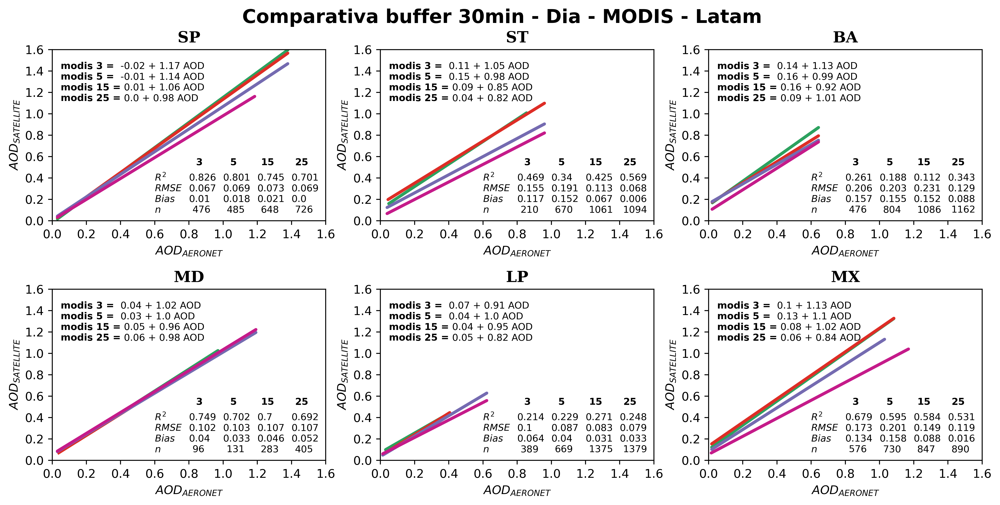

In [72]:
# Regrsion lineal C6
date_format = '%d/%m/%Y'
nrows=2
ncols=3
plot='no'

resolucion_espaciotemporal_30 = "Comparativa buffer 30min - Dia - MODIS - Latam"
dir_path_latam_30="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/Latam/espacial/30"
regresion_30 = linear_regression_plot_espacial (resolucion_espaciotemporal = resolucion_espaciotemporal_30, path=dir_path_latam_30,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)


0
1
2
3
4
5


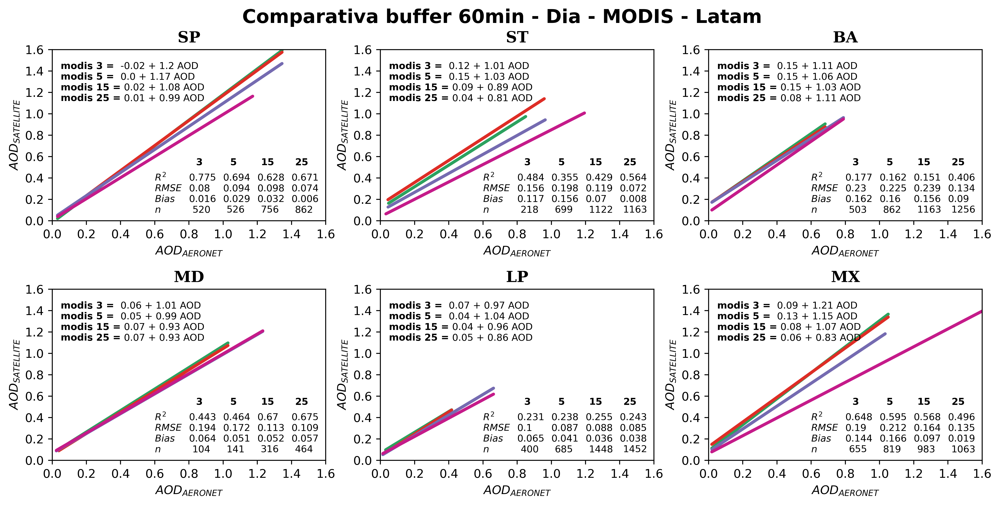

In [73]:
# Regrsion lineal C6
date_format = '%d/%m/%Y'
nrows=2
ncols=3
plot='no'

resolucion_espaciotemporal_30 = "Comparativa buffer 60min - Dia - MODIS - Latam"
dir_path_latam_30="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/Latam/espacial/60"
regresion_30 = linear_regression_plot_espacial (resolucion_espaciotemporal = resolucion_espaciotemporal_30, path=dir_path_latam_30,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)


0
1
2
3
4
5


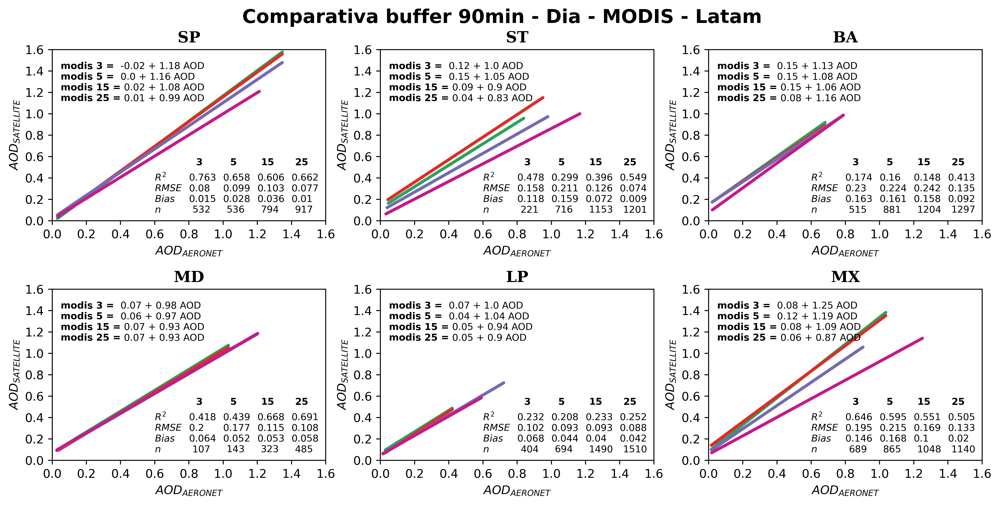

In [75]:
# Regrsion lineal C6
date_format = '%d/%m/%Y'
nrows=2
ncols=3
plot='no'

resolucion_espaciotemporal_30 = "Comparativa buffer 90min - Dia - MODIS - Latam"
dir_path_latam_30="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/Latam/espacial/90"
regresion_30 = linear_regression_plot_espacial (resolucion_espaciotemporal = resolucion_espaciotemporal_30, path=dir_path_latam_30,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)


0
1
2
3
4
5


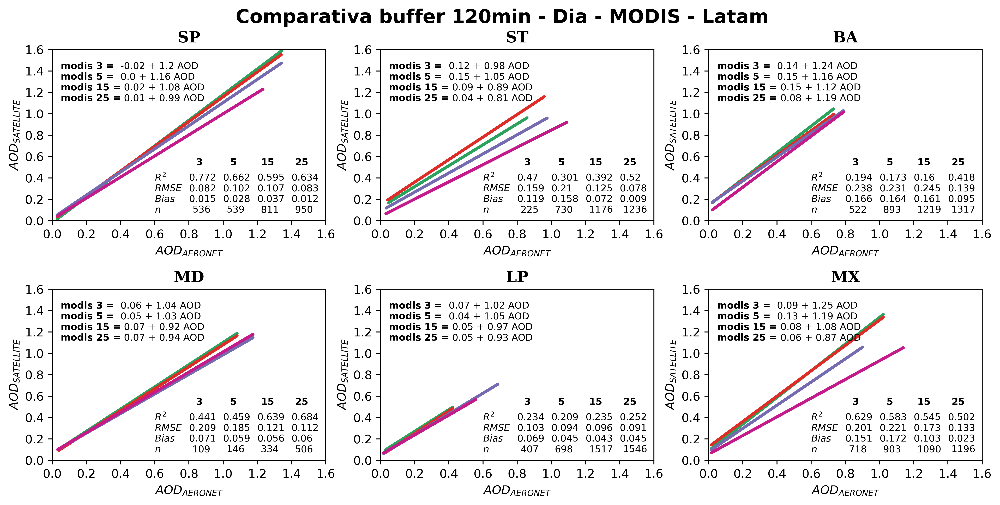

In [76]:
# Regrsion lineal C6
date_format = '%d/%m/%Y'
nrows=2
ncols=3
plot='no'

resolucion_espaciotemporal_30 = "Comparativa buffer 120min - Dia - MODIS - Latam"
dir_path_latam_30="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/Latam/espacial/120"
regresion_30 = linear_regression_plot_espacial (resolucion_espaciotemporal = resolucion_espaciotemporal_30, path=dir_path_latam_30,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)


# REU MODIS

In [10]:
def REU_list(DF,Lambda = 1, u_xi = 0.0):

    #DF = data
    Lambda = 1
    u_xi = 0.0
    Sigma_err_x = u_xi
    # These are lists where I will save the different results
    ##
    list_u_3 = []
    list_reu_3 = []
    list_bias_3 = []
    list_noise_3 = []
    list_reux_3 = []
    list_biasx_3 = []
    list_noisex_3 = []
    list_verificacion_3 = []

    list_u_5 = []
    list_reu_5 = []
    list_bias_5 = []
    list_noise_5 = []
    list_reux_5 = []
    list_biasx_5 = []
    list_noisex_5 = []

    list_u_15 = []
    list_reu_15 = []
    list_bias_15 = []
    list_noise_15 = []
    list_reux_15 = []
    list_biasx_15 = []
    list_noisex_15 = []

    list_u_25 = []
    list_reu_25 = []
    list_bias_25 = []
    list_noise_25 = []
    list_reux_25 = []
    list_biasx_25 = []
    list_noisex_25 = []

    ##
    x_3 = DF['AOD_550_AER_mean_3'] #AERONET
    y_3 = DF["AOD_550_modis_mean_3"] # Pollutant
    ##
    x_5 = DF['AOD_550_AER_mean_5'] #AERONET
    y_5 = DF["AOD_550_modis_mean_5"] # Pollutant
    ##
    x_15 = DF['AOD_550_AER_mean_15'] #AERONET
    y_15 = DF["AOD_550_modis_mean_15"] # Pollutant

    x_25 = DF['AOD_550_AER_mean_25'] #AERONET
    y_25 = DF["AOD_550_modis_mean_25"] # Pollutant

    #Masking the NaN's

    ##
    mask_3 = ~np.isnan(x_3) & ~np.isnan(y_3)
    x_3 = x_3[mask_3]
    y_3 = y_3[mask_3]
    n_3 = len(x_3)
    ##
    mask_5 = ~np.isnan(x_5) & ~np.isnan(y_5)
    x_5 = x_5[mask_5]
    y_5 = y_5[mask_5]
    n_5 = len(x_5)
    ##
    mask_15 = ~np.isnan(x_15) & ~np.isnan(y_15)
    x_15 = x_15[mask_15]
    y_15 = y_15[mask_15]
    n_15 = len(x_15)
    ##
    mask_25 = ~np.isnan(x_25) & ~np.isnan(y_25)
    x_25 = x_25[mask_25]
    y_25 = y_25[mask_25]
    n_25 = len(x_25)

    #Slope & Intercept usando REGRESION LINEAL (LR)
    #Slope & Intercept usando REGRESION LINEAL (LR)
    slope_3, intercept_3, r_3, p_3, stderr_3 = scipy.stats.linregress(x_3[mask_3], y_3[mask_3])
    b1_3 = slope_3
    b0_3 = intercept_3

    #Slope & Intercept usando REGRESION LINEAL (LR)
    slope_5, intercept_5, r_5, p_5, stderr_5 = scipy.stats.linregress(x_5[mask_5], y_5[mask_5])
    b1_5 = slope_5
    b0_5 = intercept_5

    #Slope & Intercept usando REGRESION LINEAL (LR)
    slope_15, intercept_15, r_15, p_15, stderr_15 = scipy.stats.linregress(x_15[mask_15], y_15[mask_15])
    b1_15 = slope_15
    b0_15 = intercept_15
    #Slope & Intercept usando REGRESION LINEAL (LR)
    slope_25, intercept_25, r_25, p_25, stderr_25 = scipy.stats.linregress(x_25[mask_25], y_25[mask_25])
    b1_25 = slope_25
    b0_25 = intercept_25

    #Equation error variance for y = b0 + b1*x + v_i
    rss_3 = (y_3 - b0_3 - b1_3*x_3)**2
    RSS_3 = rss_3.values.sum()
    Sigma_v_sqr_3 = RSS_3/(n_3-2)
    #Equation error variance for y = b0 + b1*x + v_i
    rss_5 = (y_5 - b0_5 - b1_5*x_5)**2
    RSS_5 = rss_5.values.sum()
    Sigma_v_sqr_5 = RSS_5/(n_5-2)
    #Equation error variance for y = b0 + b1*x + v_i
    rss_15 = (y_15 - b0_15 - b1_15*x_15)**2
    RSS_15 = rss_15.values.sum()
    Sigma_v_sqr_15 = RSS_15/(n_15-2)
    #Equation error variance for y = b0 + b1*x + v_i
    rss_25 = (y_25 - b0_25 - b1_25*x_25)**2
    RSS_25 = rss_25.values.sum()
    Sigma_v_sqr_25 = RSS_25/(n_25-2)

    #Error variance due to the deviation of the 1:1 line
    ec_3 = (b0_3 + (b1_3 - 1)*x_3)**2
    ran_3 = Sigma_v_sqr_3 - Sigma_err_x**2
    #Error variance due to the deviation of the 1:1 line
    ec_5 = (b0_5 + (b1_5 - 1)*x_5)**2
    ran_5 = Sigma_v_sqr_5 - Sigma_err_x**2
    #Error variance due to the deviation of the 1:1 line
    ec_15 = (b0_15 + (b1_15 - 1)*x_15)**2
    ran_15 = Sigma_v_sqr_15 - Sigma_err_x**2
    #Error variance due to the deviation of the 1:1 line
    ec_25 = (b0_25 + (b1_25 - 1)*x_25)**2
    ran_25 = Sigma_v_sqr_25 - Sigma_err_x**2

    #Results
    U_3 = ((ran_3  + ec_3)**(1/2))
    REU_3  = ((2*100)/y_3)*U_3 
    bias_3  = ((((2*100)/y_3)**2)*ec_3)**(1/2)
    noise_3  = ((((2*100)/y_3)**2)*ran_3)**(1/2)
    verificacion_3  = ((bias_3 **2 + noise_3 **2)**(1/2))
    verificacion_u_3  = ((bias_3 **2 + noise_3 **2)**(1/2))/((2*100)/y_3)
    REUx_3  = 2*U_3 *100/x_3
    biasx_3  = ((((2*100)/x_3 )**2)*ec_3 )**(1/2)
    noisex_3  = ((((2*100)/x_3 )**2)*ran_3 )**(1/2)
    #Results
    U_5 = ((ran_5  + ec_5)**(1/2))
    REU_5  = ((2*100)/y_5)*U_5 
    bias_5 = ((((2*100)/y_5)**2)*ec_5)**(1/2)
    noise_5  = ((((2*100)/y_5)**2)*ran_5)**(1/2)
    verificacion_5  = ((bias_5 **2 + noise_5 **2)**(1/2))
    verificacion_u_5  = ((bias_5 **2 + noise_5 **2)**(1/2))/((2*100)/y_5)
    REUx_5  = 2*U_5*100/x_5
    biasx_5  = ((((2*100)/x_5)**2)*ec_5)**(1/2)
    noisex_5  = ((((2*100)/x_5 )**2)*ran_5)**(1/2)

    #Results
    U_15 = ((ran_15  + ec_15)**(1/2))
    REU_15  = ((2*100)/y_15)*U_15 
    bias_15 = ((((2*100)/y_15)**2)*ec_15)**(1/2)
    noise_15  = ((((2*100)/y_15)**2)*ran_15)**(1/2)
    verificacion_15  = ((bias_15 **2 + noise_15 **2)**(1/2))
    verificacion_u_15  = ((bias_15 **2 + noise_15 **2)**(1/2))/((2*100)/y_15)
    REUx_15  = 2*U_15*100/x_15
    biasx_15  = ((((2*100)/x_15)**2)*ec_15)**(1/2)
    noisex_15  = ((((2*100)/x_15 )**2)*ran_15)**(1/2)
    #Results
    U_25 = ((ran_25  + ec_25)**(1/2))
    REU_25  = ((2*100)/y_25)*U_25 
    bias_25 = ((((2*100)/y_25)**2)*ec_25)**(1/2)
    noise_25  = ((((2*100)/y_25)**2)*ran_25)**(1/2)
    verificacion_25  = ((bias_25 **2 + noise_25 **2)**(1/2))
    verificacion_u_25  = ((bias_25 **2 + noise_25 **2)**(1/2))/((2*100)/y_25)
    REUx_25  = 2*U_25*100/x_25
    biasx_25  = ((((2*100)/x_25)**2)*ec_25)**(1/2)
    noisex_25  = ((((2*100)/x_25 )**2)*ran_25)**(1/2)


    #The results are each placed in a separate list
    list_u_3.append(U_3)
    list_reu_3.append(REU_3)
    list_bias_3.append(bias_3)
    list_noise_3.append(noise_3)
    list_verificacion_3.append(verificacion_3)
    list_reux_3.append(REUx_3)
    list_biasx_3.append(biasx_3)
    list_noisex_3.append(noisex_3)

    #The results are each placed in a separate list
    list_u_5.append(U_5)
    list_reu_5.append(REU_5)
    list_bias_5.append(bias_5)
    list_noise_5.append(noise_5)
    #list_verificacion_5.append(verificacion_5)
    list_reux_5.append(REUx_5)
    list_biasx_5.append(biasx_5)
    list_noisex_5.append(noisex_5)
    #The results are each placed in a separate list
    list_u_15.append(U_15)
    list_reu_15.append(REU_15)
    list_bias_15.append(bias_15)
    list_noise_15.append(noise_15)
    #list_verificacion_15.append(verificacion_15)
    list_reux_15.append(REUx_15)
    list_biasx_15.append(biasx_15)
    list_noisex_15.append(noisex_15)
    #The results are each placed in a separate list
    list_u_25.append(U_5)
    list_reu_25.append(REU_25)
    list_bias_25.append(bias_25)
    list_noise_25.append(noise_25)
    #list_verificacion_25.append(verificacion_25)
    list_reux_25.append(REUx_25)
    list_biasx_25.append(biasx_25)
    list_noisex_25.append(noisex_25)


    # The generated lists are concatenated

    REU_3 = pd.concat(list_reu_3, axis=1)
    REUx_3 = pd.concat(list_reux_3, axis=1)

    REU_5 = pd.concat(list_reu_5, axis=1)
    REUx_5 = pd.concat(list_reux_5, axis=1)

    REU_15 = pd.concat(list_reu_15, axis=1)
    REUx_15 = pd.concat(list_reux_15, axis=1)

    REU_25 = pd.concat(list_reu_25, axis=1)
    REUx_25 = pd.concat(list_reux_25, axis=1)
    # Realizar el merge de las tres columnas en un solo DataFrame
    result = pd.concat([DF['AOD_550_AER_mean_3'], REUx_3,DF['AOD_550_AER_mean_5'], REUx_5, DF['AOD_550_AER_mean_15'], REUx_15,DF['AOD_550_AER_mean_25'], REUx_25], axis=1)
    # Cambiar los nombres de las columnas
    result.columns = ["AOD_550_AER_mean_3", 'REUx_3',"AOD_550_AER_mean_5", 'REUx_5',"AOD_550_AER_mean_15", 'REUx_15',"AOD_550_AER_mean_25", 'REUx_25']

    # # Mostrar el resultado
    # result.tail(10)
    df_REUxy = result
    # df_REUxy.columns
    return df_REUxy

# REU PLOT
def REU_plot(path, date_format,nrows,ncols,plot,resolucion_espaciotemporal):
    '''
    This function allows plotting the previously calculated REU. 
    The data of each station of interest is contained in a folder in .csv format previously processed.
    This function goes through the folder and takes each of these files to later make the plot of interest.

    Variables:
    - path : path to the folder where the files in .csv format are located
    - date_format: format of the date column of the file of interest. 
    For example: date_format='%Y-%m-%d %H:%M:%S'
    - nrows: number of rows the plot will have
    - ncols: number of columnas the plot will have
    - color palette for each  for stations modis-MODIS For example: 
    color_modis = ["#74c476","#fed976","#fb6a4a", "#74a9cf","#df65b0","#807dba"]
    color_modis = ["#005a32","#fd8d3c","#99000d","#023858","#ce1256","#3f007d"]
    '''
    i=0 
    j=0 
    

    fig, ax = plt.subplots(ncols=ncols,nrows=nrows,  figsize=(14,6),dpi=500)
    fig.suptitle(resolucion_espaciotemporal, fontsize=16, fontweight='bold')
    #The folder where the files of each station are located is browsed.
    for p,files in enumerate(os.listdir(path)):
        print(p)
        N = len(os.listdir(path))
        data = pd.read_csv(os.path.join(path,files))
        station_name = files [2:4]
        
        
        df_REUxy = REU_list(DF=data,Lambda = 1, u_xi = 0.0)
        # Station Name
        station_name = files [2:4]
        ########################                VARIABLES                ########################


        x_3 = df_REUxy["AOD_550_AER_mean_3"]
        y_3 = df_REUxy["REUx_3"]
        x_5 = df_REUxy["AOD_550_AER_mean_5"]
        y_5 = df_REUxy["REUx_5"]
        x_15 = df_REUxy["AOD_550_AER_mean_15"]
        y_15 = df_REUxy["REUx_15"]
        x_25 = df_REUxy["AOD_550_AER_mean_25"]
        y_25 = df_REUxy["REUx_25"]

        #Masking the NaN's
        ##
        mask_3 = ~np.isnan(x_3) & ~np.isnan(y_3)
        x_3 = x_3[mask_3]
        y_3 = y_3[mask_3]
        n_3 = len(x_3)
        ##
        mask_5 = ~np.isnan(x_5) & ~np.isnan(y_5)
        x_5 = x_5[mask_5]
        y_5 = y_5[mask_5]
        n_5 = len(x_5)
        ##
        mask_15 = ~np.isnan(x_15) & ~np.isnan(y_15)
        x_15 = x_15[mask_15]
        y_15 = y_15[mask_15]
        n_15 = len(x_15)
        ##
        mask_25 = ~np.isnan(x_25) & ~np.isnan(y_25)
        x_25 = x_25[mask_25]
        y_25 = y_25[mask_25]
        n_25 = len(x_25)

        min_3 = round(min(y_3),2)
        max_3  =  round(max(y_3),2)
        min_5 = round(min(y_5),2)
        max_5  =  round(max(y_5),2)
        min_15 = round(min(y_15),2)
        max_15  =  round(max(y_15),2)
        min_25 = round(min(y_25),2)
        max_25  =  round(max(y_25),2)
        
        ###

        ###
        df_REUxy_min_3 = df_REUxy[df_REUxy["REUx_3"] == min(y_3)]
        AOD_550_AER_mean_3_min_REU = round(min(df_REUxy_min_3['AOD_550_AER_mean_3']),3)
        ###
        ###
        df_REUxy_min_5 = df_REUxy[df_REUxy["REUx_5"] == min(y_5)]
        AOD_550_AER_mean_5_min_REU = round(min(df_REUxy_min_5['AOD_550_AER_mean_5']),3)
        ######
        df_REUxy_min_15 = df_REUxy[df_REUxy["REUx_15"] == min(y_15)]
        AOD_550_AER_mean_15_min_REU = round(min(df_REUxy_min_15['AOD_550_AER_mean_15']),3)
        ######
        df_REUxy_min_25 = df_REUxy[df_REUxy["REUx_25"] == min(y_25)]
        AOD_550_AER_mean_25_min_REU = round(min(df_REUxy_min_25['AOD_550_AER_mean_25']),3)


        ########################                PLOT                ########################
        # Figure
        
      
        
        #Scatter plot REU vs Ref

        ax[i][j].scatter(x_3, y_3, s=10, color= "#2ca25f", alpha=0.5, linewidth=1) #verde
        ax[i][j].scatter(x_5, y_5, s=10, color="#de2d26", alpha=0.5, linewidth=1) #Rojo
        ax[i][j].scatter(x_15, y_15, s=10, color= "#feb24c", alpha=0.5, linewidth=1) #amarillo/narana
        ax[i][j].scatter(x_25, y_25, s=10, color="#c51b8a", alpha=0.5, linewidth=1) #fucsia

        ax[i][j].grid(color = 'grey', linestyle = '--', linewidth = 0.2)

       # The line with the minimum value of MIAC and MODIS is added

        ax[i][j].hlines(y=min_3 , xmin=0, xmax=1.2, color='black', linewidth=1, alpha=0.8, linestyle = '--')
        ax[i][j].hlines(y=min_5 , xmin=0, xmax=1.2, color='black', linewidth=1, alpha=0.8, linestyle = '--')
        ax[i][j].hlines(y=min_15 , xmin=0, xmax=1.2, color='black', linewidth=1, alpha=0.8, linestyle = '--')
        ax[i][j].hlines(y=min_25 , xmin=0, xmax=1.2, color='black', linewidth=1, alpha=0.8, linestyle = '--')

        ax[i][j].text(0.2,  250,(f'$REU 3 = {min_3}$'),
                      ha="left", va="center",fontdict={'family': 'serif', 
                     'color' : 'Black',
                     'weight': 'bold',
                     'size': 9})

        ax[i][j].text(0.2, 230,(f'$REU 5 = {min_5}$'),
              ha="left", va="center",fontdict={'family': 'serif', 
             'color' : 'Black',
             'weight': 'bold',
                     'size': 9})
        ax[i][j].text(0.2, 210,(f'$REU 15 = {min_15}$'),
                      ha="left", va="center",fontdict={'family': 'serif', 
                     'color' : 'Black',
                     'weight': 'bold',
                     'size': 9})
        ax[i][j].text(0.2,  190,(f'$REU 25 = {min_25}$'),
                      ha="left", va="center",fontdict={'family': 'serif', 
                             'color' : 'Black',
                             'weight': 'bold',
                             'size': 9})

#         ax[i][j].text(0.2, 270,(f'$REUmax 1 = {max_1}$'),
#                       ha="left", va="center",fontdict={'family': 'serif', 
#                      'color' : 'Black',
#                      'weight': 'bold',
#                      'size': 9})
#         ax[i][j].text(0.2,  250,(f'$REUmax 3 = {max_3}$'),
#                       ha="left", va="center",fontdict={'family': 'serif', 
#                      'color' : 'Black',
#                      'weight': 'bold',
#                      'size': 9})

#         ax[i][j].text(0.2, 230,(f'$REUmax 5 = {max_5}$'),
#               ha="left", va="center",fontdict={'family': 'serif', 
#              'color' : 'Black',
#              'weight': 'bold',
#                      'size': 9})
#         ax[i][j].text(0.2, 210,(f'$REUmax 15 = {max_15}$'),
#                       ha="left", va="center",fontdict={'family': 'serif', 
#                      'color' : 'Black',
#                      'weight': 'bold',
#                      'size': 9})
#         ax[i][j].text(0.2,  190,(f'$REUmax 25 = {max_25}$'),
#                       ha="left", va="center",fontdict={'family': 'serif', 
#                              'color' : 'Black',
#                              'weight': 'bold',
                            # 'size': 9})

#         ax[i][j].text(0.2, 270,(f'$AODaer 1 = {round(AOD_550_AER_mean_1_min_REU,3)}$'),
#                       ha="left", va="center",fontdict={'family': 'serif', 
#                      'color' : 'Black',
#                      'weight': 'bold',
#                      'size': 9})
#         ax[i][j].text(0.2,  250,(f'$AODaer 3 = {round(AOD_550_AER_mean_3_min_REU,3)}$'),
#                       ha="left", va="center",fontdict={'family': 'serif', 
#                      'color' : 'Black',
#                      'weight': 'bold',
#                      'size': 9})

#         ax[i][j].text(0.2, 230,(f'$AODaer 5 = {round(AOD_550_AER_mean_5_min_REU,3)}$'),
#               ha="left", va="center",fontdict={'family': 'serif', 
#              'color' : 'Black',
#              'weight': 'bold',
#                      'size': 9})
#         ax[i][j].text(0.2, 210,(f'$AODaer 15 = {round(AOD_550_AER_mean_15_min_REU,3)}$'),
#                       ha="left", va="center",fontdict={'family': 'serif', 
#                      'color' : 'Black',
#                      'weight': 'bold',
#                      'size': 9})
#         ax[i][j].text(0.2,  190,(f'$AODaer 25 = {round(AOD_550_AER_mean_25_min_REU,3)}$'),
#                       ha="left", va="center",fontdict={'family': 'serif', 
#                              'color' : 'Black',
#                              'weight': 'bold',
#                              'size': 9})
        # Title of each subplot corresponds toY the name of the AERONET station.
        ax[i][j].set_title(station_name,fontsize=13,fontdict={'family': 'serif', 'color' : 'Black','weight': 'bold', 'size': 16})
        # X axis limit
        ax[i][j].set_xlim(0,1.2) 
        # Y axis limit
        ax[i][j].set_ylim(0,300)
        # Axes names
        ax[i][j].set_xlabel(r'$AOD_{AERONET}$',size=10)
        ax[i][j].set_ylabel(r'REUx $AOD_{Satellite}$',size=10)
        # Configuration of subplots
        plt.subplots_adjust(left=0.125,bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.2, 
                    hspace=0.4)
        # Tittle legend
        tittle_legend = ["3km","5km","15km","25km"]
        ax[i][j].legend(tittle_legend , frameon = False, markerfirst = False, fontsize = 10)
        # Location of data in each subplot
        if j == ncols-1:
            i = i+1
            j = 0
        else:
            j = j+1
    
       # Save the plot to the current path
    if plot == 'save':
        return(plt.savefig("REU_plot.jpg", dpi=500))
    else:
        return(plt.show())
    
    
    

0
1
2
3
4
5


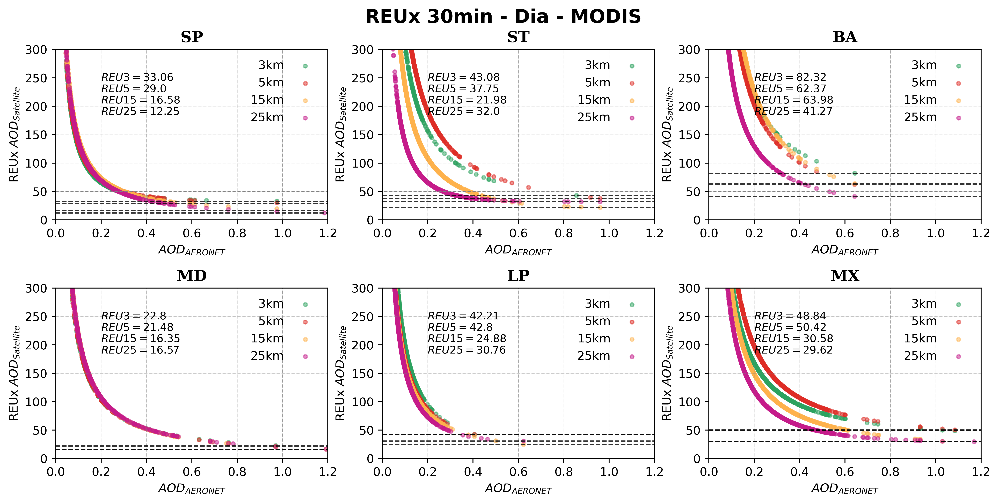

In [95]:
#"REUx 30min - Dia - C61 - Latam"
date_format='%Y-%m-%d'
nrows=2
ncols=3
plot ="no"
dir_path_30 = "D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/Latam/espacial/30/"
resolucion_espaciotemporal_30 = "REUx 30min - Dia - MODIS"
prueba_reu_plot = REU_plot(path=dir_path_30,resolucion_espaciotemporal=resolucion_espaciotemporal_30, date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)
prueba_reu_plot

0
1
2
3
4
5


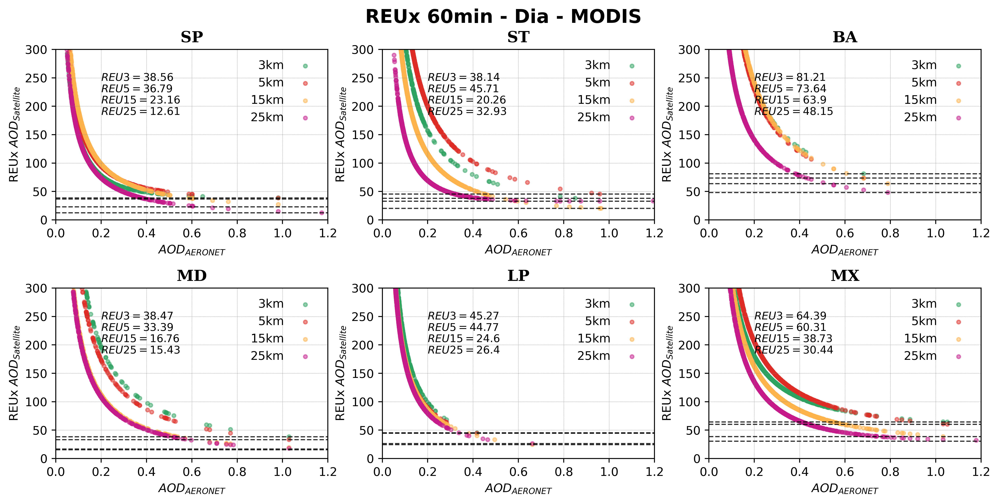

In [96]:
#"REUx 30min - Dia - C61 - Latam"
date_format='%Y-%m-%d'
nrows=2
ncols=3
plot ="no"
dir_path_30 = "D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/Latam/espacial/60/"
resolucion_espaciotemporal_30 = "REUx 60min - Dia - MODIS"
prueba_reu_plot = REU_plot(path=dir_path_30,resolucion_espaciotemporal=resolucion_espaciotemporal_30, date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)
prueba_reu_plot

0
1
2
3
4
5


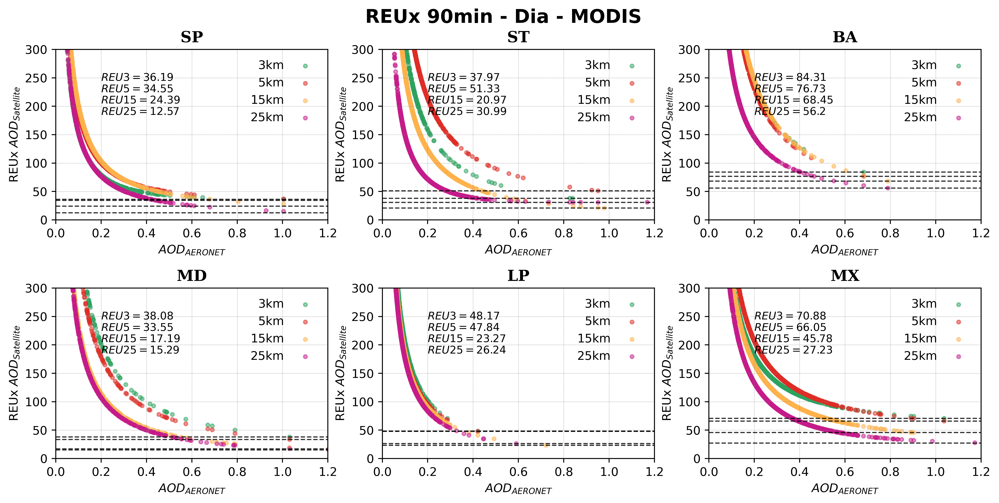

In [97]:
#"REUx 30min - Dia - C61 - Latam"
date_format='%Y-%m-%d'
nrows=2
ncols=3
plot ="no"
dir_path_30 = "D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/Latam/espacial/90/"
resolucion_espaciotemporal_30 = "REUx 90min - Dia - MODIS"
prueba_reu_plot = REU_plot(path=dir_path_30,resolucion_espaciotemporal=resolucion_espaciotemporal_30, date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)
prueba_reu_plot

0
1
2
3
4
5


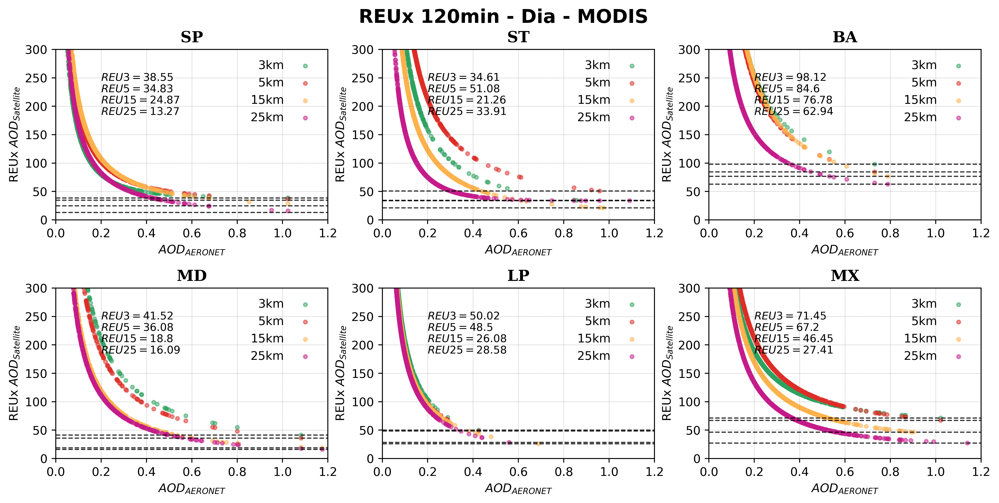

In [98]:
#"REUx 30min - Dia - C61 - Latam"
date_format='%Y-%m-%d'
nrows=2
ncols=3
plot ="no"
dir_path_30 = "D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/Latam/espacial/120/"
resolucion_espaciotemporal_30 = "REUx 120min - Dia - MODIS"
prueba_reu_plot = REU_plot(path=dir_path_30,resolucion_espaciotemporal=resolucion_espaciotemporal_30, date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)
prueba_reu_plot

# MODIS USA

0
1
2
3
4
5


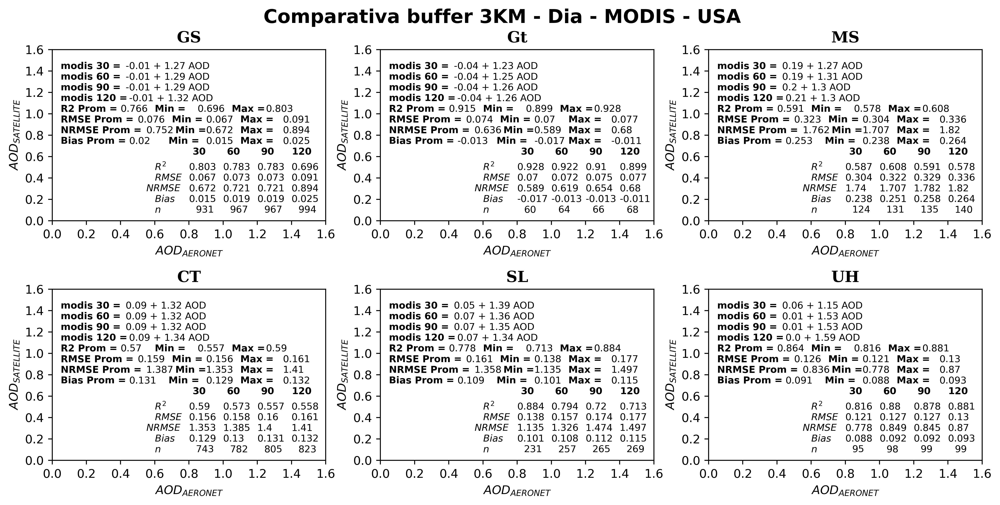

In [5]:
### "Comparativa buffer 3KM - Dia"
resolucion_espaciotemporal_3KM = "Comparativa buffer 3KM - Dia - MODIS - USA"
# date_format= '%Y-%m-%d %H:%M:%S'
date_format = '%d/%m/%Y'
ncols = 3
nrows = 2
plot = "no"
dir_path_latam_3KM="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/USA/horario/3km"
regresion_3km = linear_regression_plot (resolucion_espaciotemporal = resolucion_espaciotemporal_3KM, path=dir_path_latam_3KM,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)

0
1
2
3
4
5


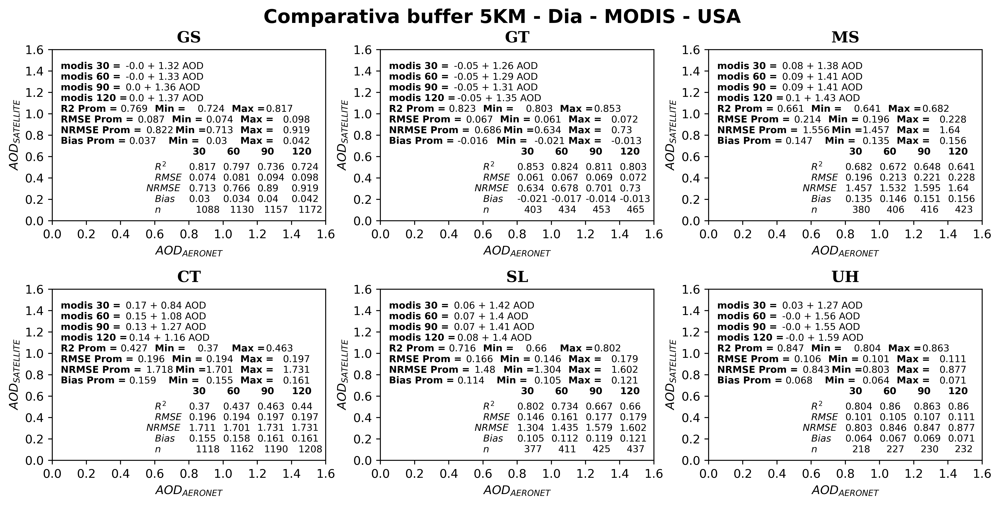

In [6]:
### "Comparativa buffer 3KM - Dia"
resolucion_espaciotemporal_3KM = "Comparativa buffer 5KM - Dia - MODIS - USA"
# date_format= '%Y-%m-%d %H:%M:%S'
date_format = '%d/%m/%Y'
ncols = 3
nrows = 2
plot = "no"
dir_path_latam_3KM="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/USA/horario/5km"
regresion_3km = linear_regression_plot (resolucion_espaciotemporal = resolucion_espaciotemporal_3KM, path=dir_path_latam_3KM,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)

0
1
2
3
4
5


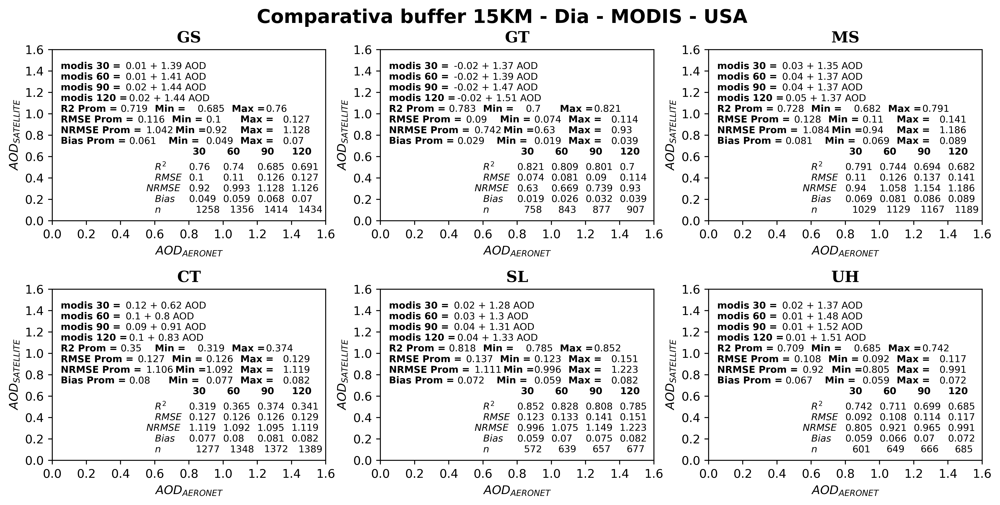

In [7]:
### "Comparativa buffer 3KM - Dia"
resolucion_espaciotemporal_3KM = "Comparativa buffer 15KM - Dia - MODIS - USA"
# date_format= '%Y-%m-%d %H:%M:%S'
date_format = '%d/%m/%Y'
ncols = 3
nrows = 2
plot = "no"
dir_path_latam_3KM="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/USA/horario/15km"
regresion_3km = linear_regression_plot (resolucion_espaciotemporal = resolucion_espaciotemporal_3KM, path=dir_path_latam_3KM,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)

0
1
2
3
4
5


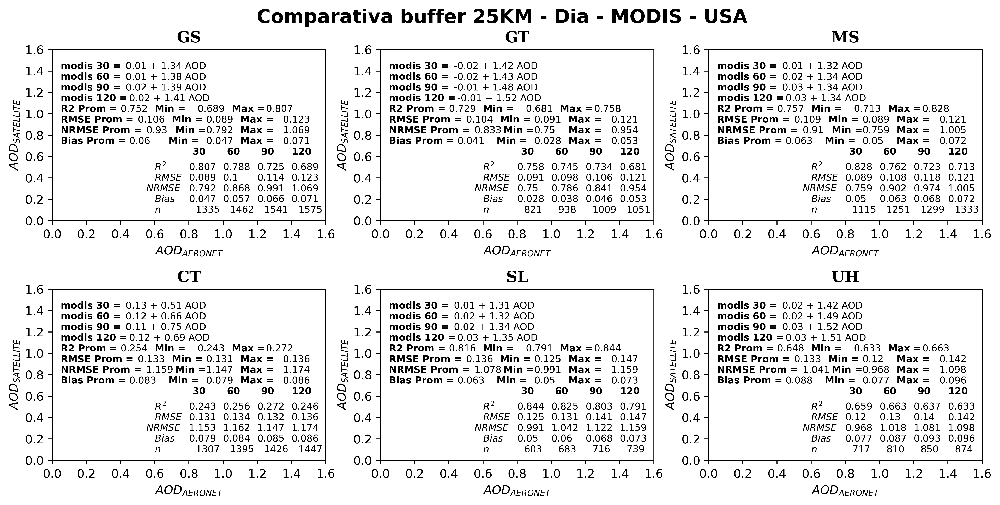

In [8]:
### "Comparativa buffer 3KM - Dia"
resolucion_espaciotemporal_3KM = "Comparativa buffer 25KM - Dia - MODIS - USA"
# date_format= '%Y-%m-%d %H:%M:%S'
date_format = '%d/%m/%Y'
ncols = 3
nrows = 2
plot = "no"
dir_path_latam_3KM="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/USA/horario/25km"
regresion_3km = linear_regression_plot (resolucion_espaciotemporal = resolucion_espaciotemporal_3KM, path=dir_path_latam_3KM,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)

0
1
2
3
4


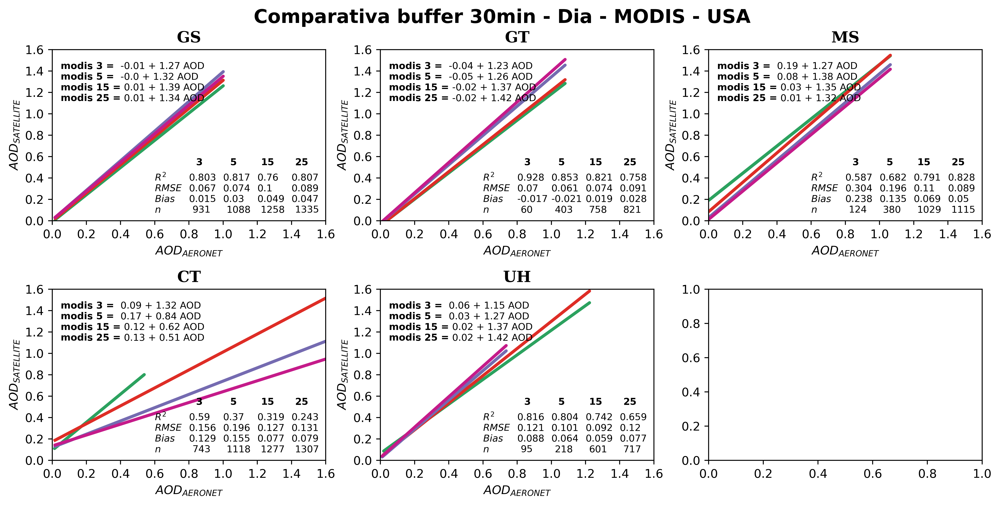

In [10]:
# Regrsion lineal C6
date_format = '%d/%m/%Y'
nrows=2
ncols=3
plot='no'

resolucion_espaciotemporal_30 = "Comparativa buffer 30min - Dia - MODIS - USA"
dir_path_latam_30="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/USA/espacial/30"
regresion_30 = linear_regression_plot_espacial (resolucion_espaciotemporal = resolucion_espaciotemporal_30, path=dir_path_latam_30,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)


0
1
2
3
4


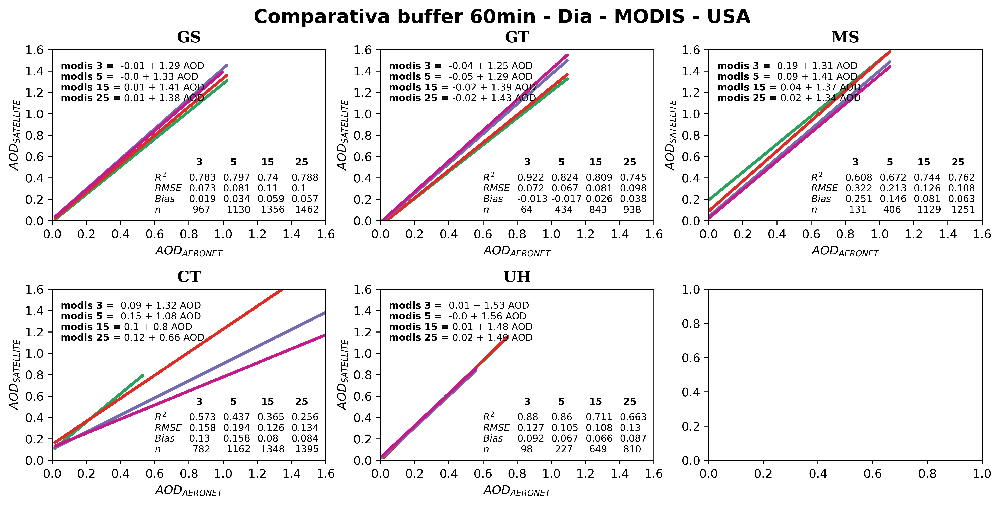

In [11]:
# Regrsion lineal C6
date_format = '%d/%m/%Y'
nrows=2
ncols=3
plot='no'

resolucion_espaciotemporal_30 = "Comparativa buffer 60min - Dia - MODIS - USA"
dir_path_latam_30="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/USA/espacial/60"
regresion_30 = linear_regression_plot_espacial (resolucion_espaciotemporal = resolucion_espaciotemporal_30, path=dir_path_latam_30,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)


0
1
2
3
4


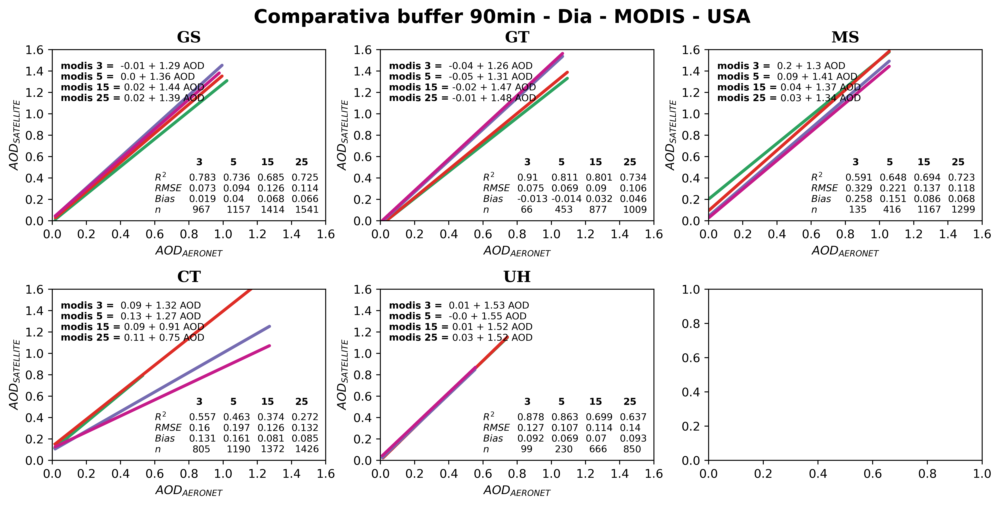

In [12]:
# Regrsion lineal C6
date_format = '%d/%m/%Y'
nrows=2
ncols=3
plot='no'

resolucion_espaciotemporal_30 = "Comparativa buffer 90min - Dia - MODIS - USA"
dir_path_latam_30="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/USA/espacial/90"
regresion_30 = linear_regression_plot_espacial (resolucion_espaciotemporal = resolucion_espaciotemporal_30, path=dir_path_latam_30,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)


0
1
2
3
4


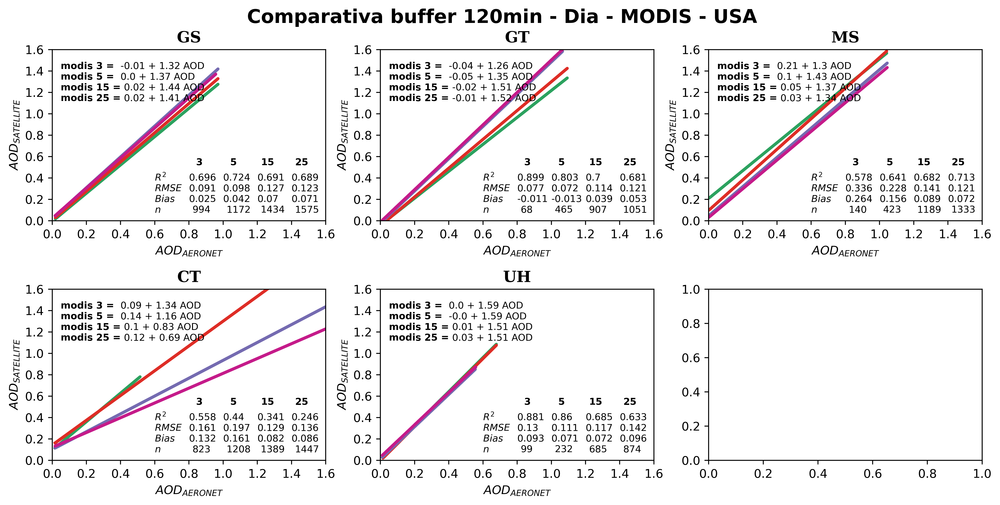

In [13]:
# Regrsion lineal C6
date_format = '%d/%m/%Y'
nrows=2
ncols=3
plot='no'

resolucion_espaciotemporal_30 = "Comparativa buffer 120min - Dia - MODIS - USA"
dir_path_latam_30="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/USA/espacial/120"
regresion_30 = linear_regression_plot_espacial (resolucion_espaciotemporal = resolucion_espaciotemporal_30, path=dir_path_latam_30,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)


0
1
2
3
4
5


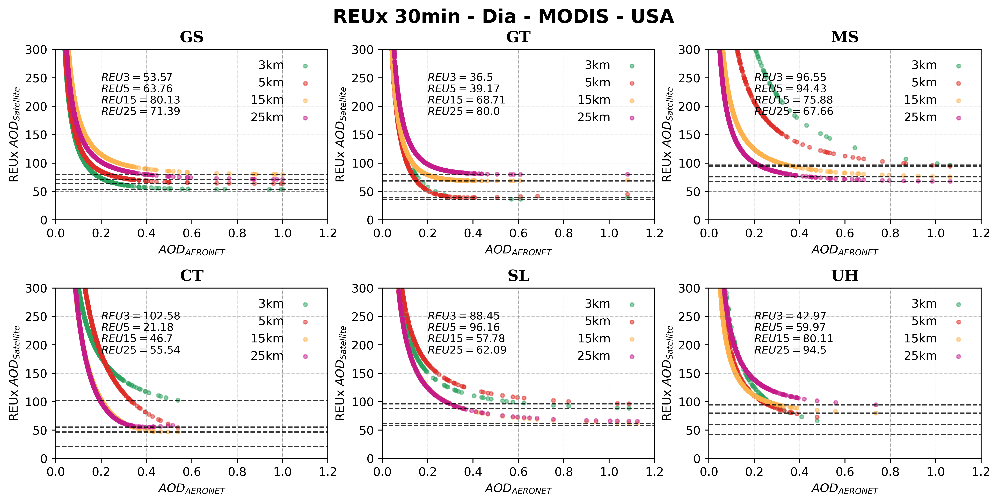

In [11]:
#"REUx 30min - Dia - C61 - Latam"
date_format='%Y-%m-%d'
nrows=2
ncols=3
plot ="no"
dir_path_30 = "D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/USA/espacial/30/"
resolucion_espaciotemporal_30 = "REUx 30min - Dia - MODIS - USA"
prueba_reu_plot = REU_plot(path=dir_path_30,resolucion_espaciotemporal=resolucion_espaciotemporal_30, date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)
prueba_reu_plot

0
1
2
3
4
5


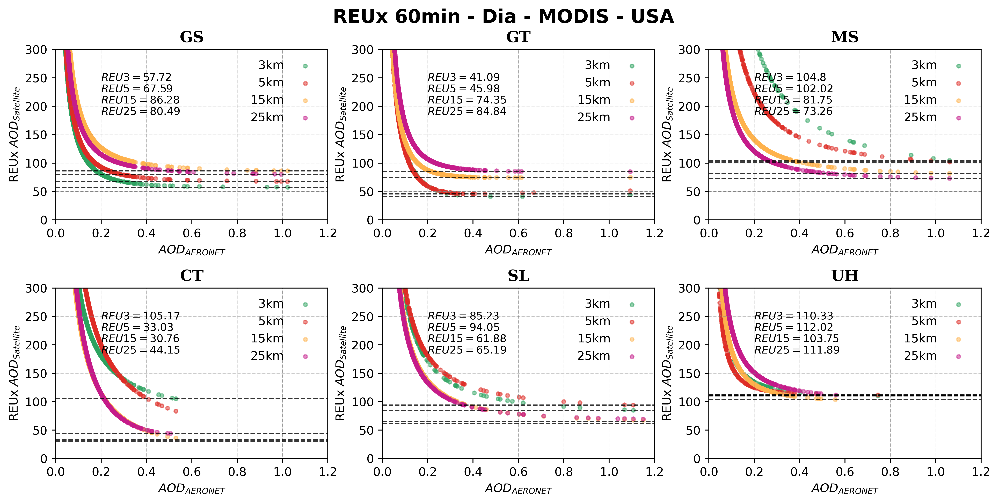

In [12]:
#"REUx 30min - Dia - C61 - Latam"
date_format='%Y-%m-%d'
nrows=2
ncols=3
plot ="no"
dir_path_30 = "D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/USA/espacial/60/"
resolucion_espaciotemporal_30 = "REUx 60min - Dia - MODIS - USA"
prueba_reu_plot = REU_plot(path=dir_path_30,resolucion_espaciotemporal=resolucion_espaciotemporal_30, date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)
prueba_reu_plot

0
1
2
3
4
5


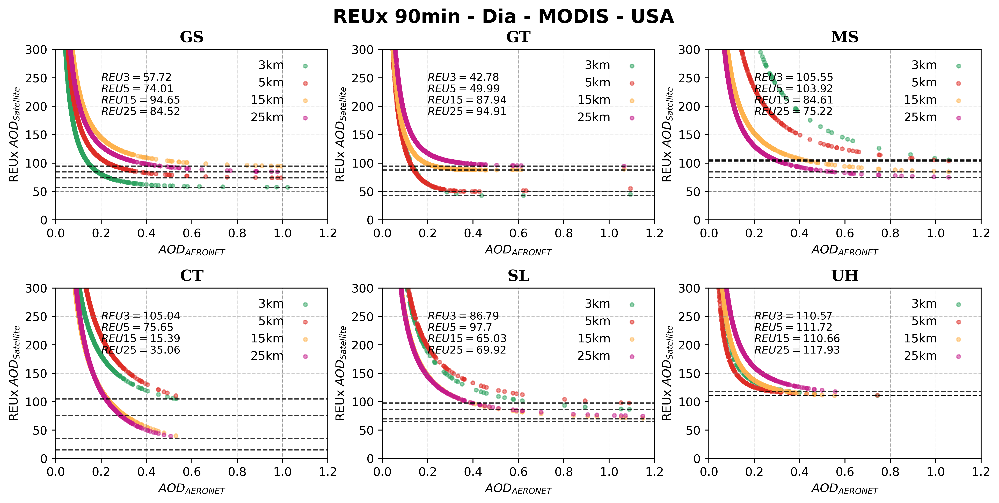

In [13]:
#"REUx 30min - Dia - C61 - Latam"
date_format='%Y-%m-%d'
nrows=2
ncols=3
plot ="no"
dir_path_30 = "D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/USA/espacial/90/"
resolucion_espaciotemporal_30 = "REUx 90min - Dia - MODIS - USA"
prueba_reu_plot = REU_plot(path=dir_path_30,resolucion_espaciotemporal=resolucion_espaciotemporal_30, date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)
prueba_reu_plot

0
1
2
3
4
5


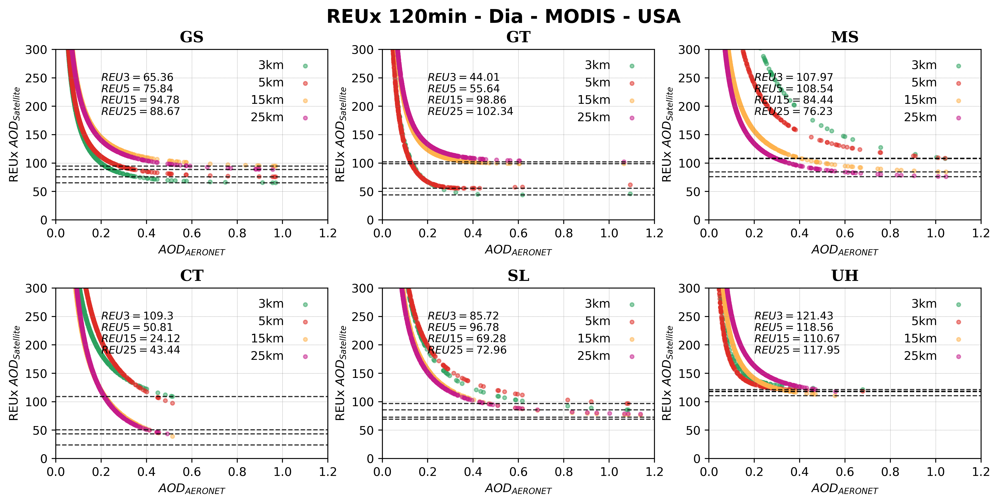

In [14]:
#"REUx 30min - Dia - C61 - Latam"
date_format='%Y-%m-%d'
nrows=2
ncols=3
plot ="no"
dir_path_30 = "D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER_MODIS/USA/espacial/120/"
resolucion_espaciotemporal_30 = "REUx 120min - Dia - MODIS - USA"
prueba_reu_plot = REU_plot(path=dir_path_30,resolucion_espaciotemporal=resolucion_espaciotemporal_30, date_format=date_format,nrows=nrows,ncols=ncols,plot=plot)
prueba_reu_plot

# MODIS VS MAIAC 6.1

In [71]:
#### Comparativa por buffer


def linear_regression_plot (path, date_format,nrows,ncols, plot, resolucion_espaciotemporal,color_maiac_61,color_maiac_60,edge_color_maiac_60,edge_color_maiac_61):
    '''
    The function allows plotting the linear regression of each AERONET station.
    In addition, the main statistics and the linear regression equation are shown.
    The data of each station of interest is contained in a folder in .csv format previously processed.
    This function goes through the folder and takes each of these files to later make the plot of interest.

    Variables:
    - path : path to the folder where the files in .csv format are located
    - date_format: format of the date column of the file of interest. 
    For example: date_format='%Y-%m-%d %H:%M:%S'
    - nrows: number of rows the plot will have
    - ncols: number of columnas the plot will have
    - color palette for each  for stations MAIAC-MODIS For example: 
    color_modis = ["#74c476","#fed976","#fb6a4a", "#74a9cf","#df65b0","#807dba"]
    color_maiac = ["#005a32","#fd8d3c","#99000d","#023858","#ce1256","#3f007d"]
    '''
    i=0 
    j=0 


    fig, ax = plt.subplots(ncols=ncols,nrows=nrows,  figsize=(14,8),dpi=500)
    fig.suptitle(resolucion_espaciotemporal, fontsize=16, fontweight='bold')
    #The folder where the files of each station are located is browsed.
    for p,files in enumerate(os.listdir(path)):
        print(p)
        N = len(os.listdir(path))
        data = pd.read_csv(os.path.join(path,files))
        station_name = files [2:4]
#data = pd.read_csv("D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_BUFFER/Latam_C61/3_BA-1km-MAIAC-AER_MEAN-TotBuff_c61.csv")
#print(data.columns)
        #date_format='%Y-%m-%d'
        data["Timestamp"] = data["date"].apply(lambda x: datetime.strptime(x,date_format))
        #data["Timestamp"] = data["date"].apply(lambda x: datetime.strptime(x,date_format))
        #Becomes the index column
        data.set_index('Timestamp', inplace = True)
        data_mean_period_len =len(data.dropna(how='all'))
        # Station Name
        ########################                VARIABLES                ########################
        #########################     DF_60 MODIS         DF_61 MAIAC
        #Separates dataframe for na values
        df_60 = data[['date', 'AOD_modis', 'AOD_modis_AER']]
        y_maiac_60= df_60["AOD_modis"]
        x_aer_60 = df_60['AOD_modis_AER']
        ##
        df_61 = data[['date', 'AOD_maiac', 'AOD_maiac_AER']]
        y_maiac_61= df_61["AOD_maiac"]
        x_aer_61 = df_61['AOD_maiac_AER']
        #Mask for every dataset
        ##60
        mask_60 = ~np.isnan(x_aer_60) & ~np.isnan(y_maiac_60)
        x_aer_60 = x_aer_60[mask_60]
        y_maiac_60 = y_maiac_60[mask_60]

        ##61
        mask_61 = ~np.isnan(x_aer_61) & ~np.isnan(y_maiac_61)
        x_aer_61 = x_aer_61[mask_61]
        y_maiac_61 = y_maiac_61[mask_61]
        
       
        # #numero de datos sin contar los NaNs
        n_60 = len(x_aer_60)
        n_61 = len(x_aer_61)
        #e, la ordenada al origen y el R2
        slope_maiac_60 , intercept_maiac_60 , r_maiac_60 , p_maiac_60 , stderr_maiac_60  = scipy.stats.linregress(x_aer_60 , y_maiac_60)
        slope_maiac_61 , intercept_maiac_61 , r_maiac_61 , p_maiac_61 , stderr_maiac_61  = scipy.stats.linregress(x_aer_61 , y_maiac_61)
               
        # R2
        R2_maiac_60 =r_maiac_60*r_maiac_60
        R2_maiac_61 =r_maiac_61*r_maiac_61


        #Calculo RMSE
        RMSE_maiac_60= mean_squared_error(y_maiac_60, x_aer_60, squared = False)
        RMSE_maiac_61 = mean_squared_error(y_maiac_61, x_aer_61, squared = False)

        
        RMSE_maiac_normalize_60 = round(RMSE_maiac_60/(x_aer_60.mean()),3)
        RMSE_maiac_normalize_61 = round(RMSE_maiac_61/(x_aer_61.mean()),3)



        #Bias
        bias_maiac_60 = round(( sum(y_maiac_60 - x_aer_60)/n_60),3)
        bias_maiac_61 = round(( sum(y_maiac_61 - x_aer_61)/n_61),3)

        

        ########################                PREDICT                ########################
        
        # #y_maiac_p= data["AOD_550_maiac_mean"].values.reshape(-1,1)
        y_maiac_p_60 = y_maiac_60.values.reshape(-1,1)
        x_p_60 = x_aer_60.values.reshape(-1,1)
        ##
        y_maiac_p_61= y_maiac_61.values.reshape(-1,1)
        x_p_61 = x_aer_61.values.reshape(-1,1)


        ######
        linear_regresion_maiac_60 = LinearRegression()
        linear_regresion_maiac_60.fit(x_p_60,y_maiac_p_60)
        li_predict_maiac_60= linear_regresion_maiac_60.predict(x_p_60)
        ##
        linear_regresion_maiac_61 = LinearRegression()
        linear_regresion_maiac_61.fit(x_p_61,y_maiac_p_61)
        li_predict_maiac_61 = linear_regresion_maiac_61.predict(x_p_61)
        ##


        #### 
        #fig.suptitle(resolucion_espaciotemporal, fontsize=16, fontweight='bold')
         ########################                PLOT                ########################
                # Figure
                #Scatter plot Unit vs Ref

        
        ax[i][j].plot(x_p_60,li_predict_maiac_60,c=color_maiac_60[p],linestyle="-",linewidth=2.5)#azul
        ax[i][j].plot(x_p_61,li_predict_maiac_61,c=color_maiac_61[p],linestyle="-",linewidth=2.5)#verde
        ax[i][j].scatter(x_p_60, y_maiac_p_60,  c=color_maiac_60[p],edgecolors=edge_color_maiac_60[p] ,alpha=0.5,  s=25,label="MODIS")
        #
        ax[i][j].scatter(x_p_60, y_maiac_p_61,  c=color_maiac_61[p] ,edgecolors=edge_color_maiac_61[p] ,alpha=0.5,  s=25,label="MAIAC")

        ax[i][j].set_xlim(0, 1.8)
        ax[i][j].set_ylim(0, 1.8)
        ax[i][j].yaxis.set_ticks(np.arange(0.2, 1.85, 0.4))
        ax[i][j].xaxis.set_ticks(np.arange(0.2, 1.85, 0.4))
       
        ax[i][j].text(0.03, 1.6, "MODIS =" , fontsize=14, ha="left", va="bottom", fontweight = "bold")
        ax[i][j].text(0.03, 1.45, "MAIAC =", fontsize=14, ha="left", va="bottom",fontweight = "bold")
        ax[i][j].text(0.46, 1.6, (str(round (intercept_maiac_60,2)) + " + "+ str(round (slope_maiac_60,2)) + " AOD") , fontsize=14, ha="left", va="bottom")#, bbox=dict(boxstyle="round", fc=(1.0, 0.99, 0.99)))
        ax[i][j].text(0.46, 1.45, (str(round (intercept_maiac_61,2)) + " + "+ str(round (slope_maiac_61,2))+ " AOD") , fontsize=14, ha="left", va="bottom")#, bbox=dict(boxstyle="round", fc=(1.0, 0.99, 0.99)))
                # Statistics by station
        ax[i][j].text(1.27, 0.68, "MODIS" , fontsize=13, ha="center", va="bottom", fontweight = "bold")
        ax[i][j].text(1.60, 0.68, "MAIAC" , fontsize=13, ha="center", va="bottom",fontweight = "bold")
        ax[i][j].text(0.85, 0.55, r'$R^{2}$ ', fontsize=14, ha="left", va="center")
        ax[i][j].text(0.85, 0.40, r'$RMSE$ ',fontsize=14,ha="left", va="center")
        ax[i][j].text(0.85, 0.25, r'$Bias$', fontsize=14,ha="left", va="center")
        ax[i][j].text(0.85, 0.1, r'$n$    ', fontsize=14,ha="left", va="center")

        #Statistics by station for MODIS
        ax[i][j].text(1.15, 0.55,(round(R2_maiac_60,2)) , fontsize=14, ha="left", va="center")
        ax[i][j].text(1.15, 0.40,  (round(RMSE_maiac_60,2)) , fontsize=14,ha="left", va="center")
        ax[i][j].text(1.15, 0.25, (round(bias_maiac_60,2)) , fontsize=14,ha="left", va="center")#,
        ax[i][j].text(1.15, 0.1, n_60 , fontsize=14,ha="left", va="center")

        # Statistics by station for  MAIAC
        ax[i][j].text(1.50, 0.55,(round(R2_maiac_61,2)) , fontsize=14, ha="left", va="center")
        ax[i][j].text(1.50, 0.40,   (round(RMSE_maiac_61,2)) , fontsize=14,ha="left", va="center")
        ax[i][j].text(1.50, 0.25,  (round(bias_maiac_61,2)), fontsize=14,ha="left", va="center")#,
        ax[i][j].text(1.50, 0.1,  n_61 , fontsize=14,ha="left", va="center")
        
        #Title of each subplot corresponds to the name of the AERONET station.
        ax[i][j].set_title(station_name,fontsize=17,fontdict={'family': 'serif', 
            'color' : 'Black',
            'weight': 'bold',
            'size': 20})
         # Tittle legend
       # tittle_legend = ["MODIS","MAIAC"]
        #ax[i][j].legend(frameon = False, markerfirst = False, fontsize = 10,loc='upper right')
        # Axes names
        ax[0][0].set_xlabel(r'',size=12)
        ax[0][1].set_xlabel(r'',size=12)
        ax[0][2].set_xlabel(r'',size=12)
        ax[1][0].set_xlabel(r'$AOD_{AERONET}$',size=17)
        ax[1][1].set_xlabel(r'$AOD_{AERONET}$',size=17)
        ax[1][2].set_xlabel(r'$AOD_{AERONET}$',size=17)
        
        
        ax[0][1].set_ylabel(r'$AOD_{SATELLITE}$',size=17)
        ax[0][1].set_ylabel(r'',size=17)
        ax[0][2].set_ylabel(r'',size=17)
        ax[1][0].set_ylabel(r'$AOD_{SATELLITE}$',size=17)
        ax[1][1].set_ylabel(r'',size=17)
        ax[1][2].set_ylabel(r'',size=17)
        
            
        


        
        plt.subplots_adjust(left=0.01,#0.125,
                    bottom=0.01,#0.1, 
                    right=0.99,#0.9, 
                    top=0.99,#0.9, 
                    wspace=0.2, 
                    hspace=0.25)#0.4)
        #ax[i][j].legend(frameon = True, markerfirst = True, fontsize = 13,loc='upper right')
        ax[i][j].legend(frameon=True, 
              markerfirst=True, 
              fontsize=13, 
              loc='upper right', 
              borderpad=0.2,  # Reduce el tamaño del recuadro
              borderaxespad=0.22)  # Ajusta el espacio entre la leyenda y el gráfico
        #ax[i][j].legend(bbox_to_anchor=(0.85, 1.03), loc='upper right', frameon=True, markerfirst=False, fontsize=10)

        print(f'{station_name} ==> MODIS =  {round(R2_maiac_60,3)}, R MAIAC =  {round(R2_maiac_61,3)}')
                #Linea 1:1:
        x_linea11 = np.linspace(0, 5,10)  # Genera 100 puntos entre 0 y 10
        y_linea11 = x_linea11
        ax[i][j].plot(x_linea11,y_linea11,c="#636363",linestyle="--",linewidth=1.3)#azul
#         ax[0][0].text(1.15, 0.55,("0.85") , fontsize=14, ha="left", va="center")
#         ax[1][0].text(1.50, 0.55,("0.50") , fontsize=14, ha="left", va="center")
#         ax[1][0].text(1.15, 0.40,  ("0.10") , fontsize=14,ha="left", va="center")
#         ax[1][1].text(1.15, 0.40,  ("0.10") , fontsize=14,ha="left", va="center")
        ax[i][j].tick_params(axis='both', which='major', labelsize=13)  


        # Location of data in each subplot
        if j == ncols-1:
            i = i+1
            j = 0
        else:
            j = j+1
   # Save the plot to the current path
    if plot == 'save':
        return(plt.savefig("D:/Josefina/Congresos/EGU_2024/plots_02/linear_regression_plot_EU.jpg", dpi=500))
    else:
        return(plt.show())


0
SP ==> MODIS =  0.797, R MAIAC =  0.808
1
ST ==> MODIS =  0.495, R MAIAC =  0.754
2
BA ==> MODIS =  0.18, R MAIAC =  0.351
3
MD ==> MODIS =  0.59, R MAIAC =  0.501
4
LP ==> MODIS =  0.231, R MAIAC =  0.254
5
MX ==> MODIS =  0.655, R MAIAC =  0.672


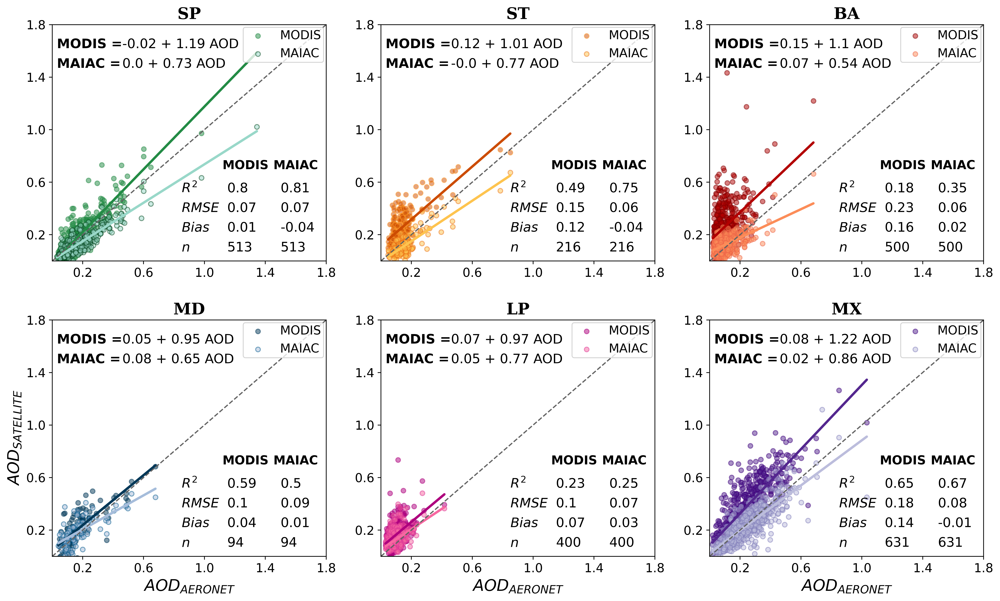

In [72]:
# Regrsion lineal C6
#date_format='%d/%m/%Y'
date_format='%Y-%m-%d'
nrows=2
ncols=3
plot='not'
### "Comparativa buffer 30min - Dia"

# edge_color_maiac_60 =["#238b45","#ae017e","#3f007d","#023858","#662506","#7f0000"]#######
# color_maiac_60 = ["#238b45","#ae017e","#54278f","#023858","#cc4c02","#b30000"]#########"

# edge_color_maiac_61 = ["#00441b","#dd3497","#807dba","#045a8d","#ec7014","#ef6548"]
# color_maiac_61 = ["#99d8c9","#f768a1","#bcbddc", "#a6bddb","#fec44f","#fc8d59"]





edge_color_maiac_60 =["#238b45","#fe9929","#7f0000","#023858","#ae017e","#3f007d"]#######
color_maiac_60 = ["#238b45","#cc4c02","#b30000","#023858","#ae017e","#54278f"]#########"

edge_color_maiac_61 = ["#00441b","#ec7014","#ef6548","#045a8d","#dd3497","#807dba"]
color_maiac_61 = ["#99d8c9","#fec44f","#fc8d59", "#a6bddb","#f768a1","#bcbddc"]






colors =["#99d8c9","#fa9fb5","#a6bddb","#756bb1","#fec44f","#fc9272"]
#resolucion_espaciotemporal = "Collection 60min-1km  USA"
resolucion_espaciotemporal = ""
dir_path_latam ="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_AER-MAIAC-MODIS/Latam_C61"
regresion = linear_regression_plot (resolucion_espaciotemporal = resolucion_espaciotemporal, path=dir_path_latam,date_format=date_format,nrows=nrows,ncols=ncols,plot=plot,color_maiac_61=color_maiac_61,color_maiac_60=color_maiac_60,edge_color_maiac_60=edge_color_maiac_60,edge_color_maiac_61=edge_color_maiac_61)


In [13]:
def REU_list(DF,Lambda = 1, u_xi = 0.0):

    #DF = data
    Lambda = 1
    u_xi = 0.0
    Sigma_err_x = u_xi
    # These are lists where I will save the different results
    list_u_1 = []
    list_reu_1 = []
    list_bias_1 = []
    list_noise_1 = []
    list_reux_1 = []
    list_biasx_1 = []
    list_noisex_1 = []
    ##
    list_u_3 = []
    list_reu_3 = []
    list_bias_3 = []
    list_noise_3 = []
    list_reux_3 = []
    list_biasx_3 = []
    list_noisex_3 = []
    list_verificacion_3 = []

    x_1 = DF['AOD_modis_AER'] #AERONET
    y_1 = DF["AOD_modis"] # Pollutant
    ##
    x_3 = DF['AOD_maiac_AER'] #AERONET
    y_3 = DF["AOD_maiac"] # Pollutant
    ##    
    
    
    #Masking the NaN's
    mask_1 = ~np.isnan(x_1) & ~np.isnan(y_1)
    x_1 = x_1[mask_1]
    y_1 = y_1[mask_1]
    n_1 = len(x_1)
    ##
    mask_3 = ~np.isnan(x_3) & ~np.isnan(y_3)
    x_3 = x_3[mask_3]
    y_3 = y_3[mask_3]
    n_3 = len(x_3)
    ##
    #Slope & Intercept usando REGRESION LINEAL (LR)
    slope_1, intercept_1, r_1, p_1, stderr_1 = scipy.stats.linregress(x_1[mask_1], y_1[mask_1])
    b1_1 = slope_1
    b0_1 = intercept_1
    #Slope & Intercept usando REGRESION LINEAL (LR)
    slope_3, intercept_3, r_3, p_3, stderr_3 = scipy.stats.linregress(x_3[mask_3], y_3[mask_3])
    b1_3 = slope_3
    b0_3 = intercept_3
    #Equation error variance for y = b0 + b1*x + v_i
    rss_1 = (y_1 - b0_1 - b1_1*x_1)**2
    RSS_1 = rss_1.values.sum()
    Sigma_v_sqr_1 = RSS_1/(n_1-2)
    #Equation error variance for y = b0 + b1*x + v_i
    rss_3 = (y_3 - b0_3 - b1_3*x_3)**2
    RSS_3 = rss_3.values.sum()
    Sigma_v_sqr_3 = RSS_3/(n_3-2)

    #Error variance due to the deviation of the 1:1 line
    ec_1 = (b0_1 + (b1_1 - 1)*x_1)**2
    ran_1 = Sigma_v_sqr_1 - Sigma_err_x**2
    #Error variance due to the deviation of the 1:1 line
    ec_3 = (b0_3 + (b1_3 - 1)*x_3)**2
    ran_3 = Sigma_v_sqr_3 - Sigma_err_x**2
    #Error variance due to the deviation of the 1:1 line

    #Results
    U_1 = ((ran_1  + ec_1 )**(1/2))
    REU_1  = ((2*100)/y_1 )*U_1 
    bias_1  = ((((2*100)/y_1 )**2)*ec_1 )**(1/2)
    noise_1  = ((((2*100)/y_1 )**2)*ran_1 )**(1/2)
    verificacion_1  = ((bias_1 **2 + noise_1 **2)**(1/2))
    verificacion_u_1  = ((bias_1 **2 + noise_1 **2)**(1/2))/((2*100)/y_1 )
    REUx_1  = 2*U_1 *100/x_1 
    biasx_1  = ((((2*100)/x_1 )**2)*ec_1 )**(1/2)
    noisex_1  = ((((2*100)/x_1 )**2)*ran_1 )**(1/2)
    #Results
    U_3 = ((ran_3  + ec_3)**(1/2))
    REU_3  = ((2*100)/y_3)*U_3 
    bias_3  = ((((2*100)/y_3)**2)*ec_3)**(1/2)
    noise_3  = ((((2*100)/y_3)**2)*ran_3)**(1/2)
    verificacion_3  = ((bias_3 **2 + noise_3 **2)**(1/2))
    verificacion_u_3  = ((bias_3 **2 + noise_3 **2)**(1/2))/((2*100)/y_3)
    REUx_3  = 2*U_3 *100/x_3
    biasx_3  = ((((2*100)/x_3 )**2)*ec_3 )**(1/2)
    noisex_3  = ((((2*100)/x_3 )**2)*ran_3 )**(1/2)


    #The results are each placed in a separate list
    list_u_1.append(U_1)
    list_reu_1.append(REU_1)
    list_bias_1.append(bias_1)
    list_noise_1.append(noise_1)
    #list_verificacion_1.append(verificacion_1)
    list_reux_1.append(REUx_1)
    list_biasx_1.append(biasx_1)
    list_noisex_1.append(noisex_1)
    #The results are each placed in a separate list
    list_u_3.append(U_3)
    list_reu_3.append(REU_3)
    list_bias_3.append(bias_3)
    list_noise_3.append(noise_3)
    list_verificacion_3.append(verificacion_3)
    list_reux_3.append(REUx_3)
    list_biasx_3.append(biasx_3)
    list_noisex_3.append(noisex_3)


    # The generated lists are concatenated
    U_1 = pd.concat(list_u_1, axis=1)
    REU_1 = pd.concat(list_reu_1, axis=1)
    REUx_1 = pd.concat(list_reux_1, axis=1)

    REU_3 = pd.concat(list_reu_3, axis=1)
    REUx_3 = pd.concat(list_reux_3, axis=1)
    # Realizar el merge de las tres columnas en un solo DataFrame
    
    
    result = pd.concat([DF['AOD_modis_AER'], REUx_1,DF['AOD_maiac_AER'], REUx_3], axis=1)
    # Cambiar los nombres de las columnas
    result.columns = ["AOD_modis_AER", 'REUx_modis',"AOD_maiac_AER", 'REUx_maiac']

    # # Mostrar el resultado
    # result.tail(10)
    df_REUxy = result
    # df_REUxy.columns
    return df_REUxy
###################################################################################################################
###################################################################################################################
# REU PLOT
def REU_plot(path, date_format,nrows,ncols,plot,resolucion_espaciotemporal,color_maiac_60, edge_color_maiac_60,color_maiac_61, edge_color_maiac_61):
    '''
    This function allows plotting the previously calculated REU. 
    The data of each station of interest is contained in a folder in .csv format previously processed.
    This function goes through the folder and takes each of these files to later make the plot of interest.

    Variables:
    - path : path to the folder where the files in .csv format are located
    - date_format: format of the date column of the file of interest. 
    For example: date_format='%Y-%m-%d %H:%M:%S'
    - nrows: number of rows the plot will have
    - ncols: number of columnas the plot will have
    - color palette for each  for stations MAIAC-MODIS For example: 
    color_modis = ["#74c476","#fed976","#fb6a4a", "#74a9cf","#df65b0","#807dba"]
    color_maiac = ["#005a32","#fd8d3c","#99000d","#023858","#ce1256","#3f007d"]
    '''
    i=0 
    j=0 
    

    fig, ax = plt.subplots(ncols=ncols,nrows=nrows,  figsize=(14,8),dpi=500)
    fig.suptitle(resolucion_espaciotemporal, fontsize=16, fontweight='bold')
    #The folder where the files of each station are located is browsed.
    for p,files in enumerate(os.listdir(path)):
        print(p)
        N = len(os.listdir(path))
        data = pd.read_csv(os.path.join(path,files))
        station_name = files [2:4]
        
        
        df_REUxy = REU_list(DF=data,Lambda = 1, u_xi = 0.0)
        # Station Name
        station_name = files [2:4]
        ########################                VARIABLES                ########################

        x_1 = df_REUxy["AOD_modis_AER"]
        y_1 = df_REUxy["REUx_modis"]
        x_3 = df_REUxy["AOD_maiac_AER"]
        y_3 = df_REUxy["REUx_maiac"]


        #Masking the NaN's
        mask_1 = ~np.isnan(x_1) & ~np.isnan(y_1)
        x_1 = x_1[mask_1]
        y_1 = y_1[mask_1]
        n_1 = len(x_1)
        ##
        mask_3 = ~np.isnan(x_3) & ~np.isnan(y_3)
        x_3 = x_3[mask_3]
        y_3 = y_3[mask_3]
        n_3 = len(x_3)
        ##

        min_1 = round(min(y_1),2)
        max_1  =  round(max(y_1),2)
        min_3 = round(min(y_3),2)
        max_3  =  round(max(y_3),2)
        
        ###
        df_REUxy_min_1 = df_REUxy[df_REUxy["REUx_modis"] == min(y_1)]
        AOD_550_AER_mean_1_min_REU = round(min(df_REUxy_min_1['AOD_modis_AER']),3)
        ###
        df_REUxy_min_3 = df_REUxy[df_REUxy["REUx_maiac"] == min(y_3)]
        AOD_550_AER_mean_3_min_REU = round(min(df_REUxy_min_3['AOD_maiac_AER']),3)


        ########################                PLOT                ########################
        # Figure
        
        
        #Scatter plot REU vs Ref
        ax[i][j].scatter(x_1, y_1, s=20,  c=color_maiac_60[p],edgecolors=edge_color_maiac_60[p], alpha=0.5, linewidth=1,label="MODIS") ##azul
        ax[i][j].scatter(x_3, y_3, s=20,  c=color_maiac_61[p],edgecolors=edge_color_maiac_61[p], alpha=0.5, linewidth=1, label="MAIAC") #verde

        ax[i][j].grid(color = 'grey', linestyle = '--', linewidth = 0.2)

       # The line with the minimum value of MIAC and MODIS is added
        ax[i][j].hlines(y= min_1, xmin=0, xmax=1.2, color='black', linewidth=1, alpha=0.8, linestyle = '--')
        ax[i][j].hlines(y=min_3 , xmin=0, xmax=1.2, color='black', linewidth=1, alpha=0.8, linestyle = '--')
        
        sp_media = 0.18
        st_media = 0.16
        ba_media = 0.11
        md_media = 0.2
        lp_media = 0.08
        mx_media = 0.29
        
        ax[0][0].vlines(x= sp_media, ymin=0, ymax=300, color=edge_color_maiac_60[0], linewidth=1.5, alpha=0.8, linestyle = '-', label="AERONET")
        ax[0][1].vlines(x= st_media, ymin=0, ymax=300, color=edge_color_maiac_60[1], linewidth=1.5, alpha=0.8, linestyle = '-')
        ax[0][2].vlines(x= ba_media, ymin=0, ymax=300, color=edge_color_maiac_60[2], linewidth=1.5, alpha=0.8, linestyle = '-')
        ax[1][0].vlines(x= md_media, ymin=0, ymax=300, color=edge_color_maiac_60[3], linewidth=1.5, alpha=0.8, linestyle = '-')
        ax[1][1].vlines(x= lp_media, ymin=0, ymax=300, color=edge_color_maiac_60[4], linewidth=1.5, alpha=0.8, linestyle = '-')
        ax[1][2].vlines(x= mx_media, ymin=0, ymax=300, color=edge_color_maiac_60[5], linewidth=1.5, alpha=0.8, linestyle = '-')
        ax[0][0].text(sp_media-0.05, 150, "AER mean", rotation=90, va='center',size=9)
        ax[0][1].text(st_media-0.05, 150, "AER mean", rotation=90, va='center',size=9)
        ax[0][2].text(ba_media-0.05, 150, "AER mean", rotation=90, va='center',size=9)
        ax[1][0].text(md_media-0.05, 150, "AER mean", rotation=90, va='center',size=9)
        ax[1][1].text(lp_media-0.05, 150, "AER mean", rotation=90, va='center',size=9)
        ax[1][2].text(mx_media-0.05, 150, "AER mean", rotation=90, va='center',size=9)
        
        

        #(r'REUx $AOD_{Satellite}$',size=14)
        ax[i][j].text(0.2, 270,(r'$REU_{MODIS}$'+ f'$= {min_1}$'),
                      ha="left", va="center",fontdict={'family': 'serif', 
                     'color' : 'Black',
                     'weight': 'bold',
                     'size': 11})
        ax[i][j].text(0.2,  230,(r'$REU_{MAIAC}$'+ f'$= {min_3}$'),
                      ha="left", va="center",fontdict={'family': 'serif', 
                     'color' : 'Black',
                     'weight': 'bold',
                     'size': 11})
        # Title of each subplot corresponds toY the name of the AERONET station.
        ax[i][j].set_title(station_name,fontsize=16,fontdict={'family': 'serif', 'color' : 'Black','weight': 'bold', 'size': 16})
        # X axis limit
        ax[i][j].set_xlim(0,1.2) 
        # Y axis limit
        ax[i][j].set_ylim(0,300)
        # Axes names
        ax[0][0].set_xlabel(r'',size=10)
        ax[0][1].set_xlabel(r' ',size=10)
        ax[0][2].set_xlabel(r' ',size=10)
        ax[1][0].set_xlabel(r'$AOD_{AERONET}$ ',size=14)
        ax[1][1].set_xlabel(r'$AOD_{AERONET}$ ',size=14)
        ax[1][2].set_xlabel(r' $AOD_{AERONET}$',size=14)
        
        ax[0][0].set_ylabel(r'REUx $AOD_{Satellite}$',size=14)
        ax[0][1].set_ylabel(r'',size=10)
        ax[0][2].set_ylabel(r'',size=10)
        ax[1][0].set_ylabel(r'REUx $AOD_{Satellite}$',size=14)
        ax[1][1].set_ylabel(r'',size=10)
        ax[1][2].set_ylabel(r'',size=10)
        # Configuration of subplots
        plt.subplots_adjust(left=0.125,bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.2, 
                    hspace=0.4)
        # Tittle legend
        #tittle_legend = ["C60","C61"]
        ax[i][j].legend( frameon = False, markerfirst = False, fontsize = 12)
        # Location of data in each subplot
        if j == ncols-1:
            i = i+1
            j = 0
        else:
            j = j+1
    
       # Save the plot to the current path
    if plot == 'save':
        return(plt.savefig("REU_plot.jpg", dpi=500))
    else:
        return(plt.show())
    
    
    

0
1
2
3
4
5


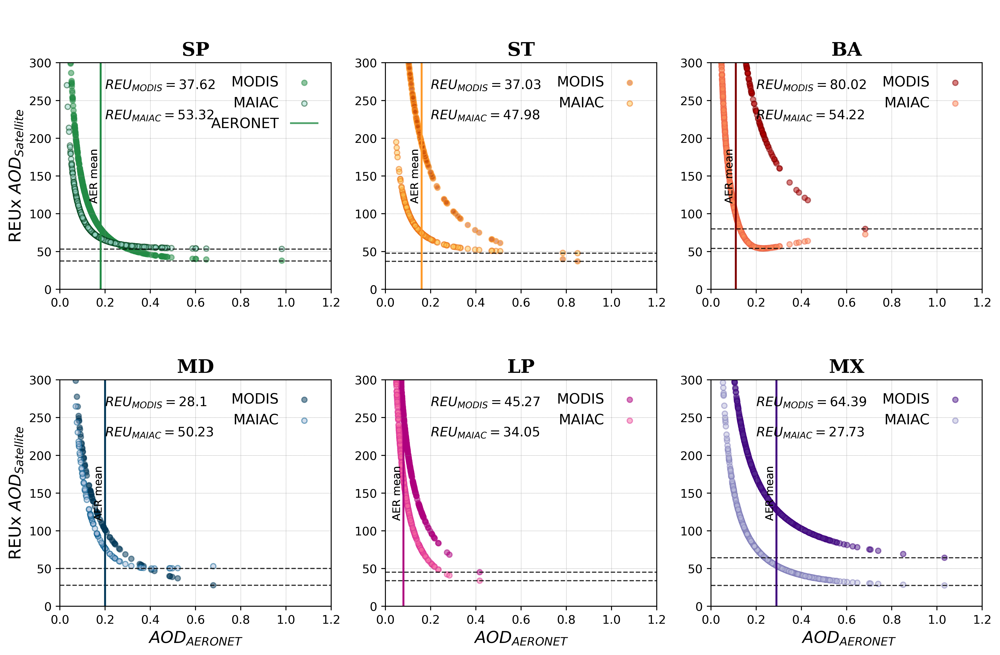

In [14]:

#"REUx 30min - Dia - C61 - Latam"
date_format='%Y-%m-%d'
nrows=2
ncols=3
plot ="no"
edge_color_maiac_60 =["#238b45","#fe9929","#7f0000","#023858","#ae017e","#3f007d"]#######
color_maiac_60 = ["#238b45","#cc4c02","#b30000","#023858","#ae017e","#54278f"]#########"

edge_color_maiac_61 = ["#00441b","#ec7014","#ef6548","#045a8d","#dd3497","#807dba"]
color_maiac_61 = ["#99d8c9","#fec44f","#fc8d59", "#a6bddb","#f768a1","#bcbddc"]

dir_path_latam ="D:/Josefina/paper_git/paper_maiac/datasets/V02/processed/merge_AER-MAIAC-MODIS/Latam_C61"
resolucion_espaciotemporal_30 = "  "
prueba_reu_plot = REU_plot(path=dir_path_latam,resolucion_espaciotemporal=resolucion_espaciotemporal_30, date_format=date_format,nrows=nrows,ncols=ncols,plot=plot,color_maiac_60=color_maiac_60, edge_color_maiac_60=edge_color_maiac_60,color_maiac_61=color_maiac_61, edge_color_maiac_61=edge_color_maiac_61)
prueba_reu_plot